In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
sns.set_theme(style="whitegrid")

In [2]:
train=pd.read_csv("C:\\Users\\Dell\\Desktop\\GDZ Elektrik Datathon\\train.csv")
test=pd.read_csv("C:\\Users\\Dell\\Desktop\\GDZ Elektrik Datathon\\test.csv")
holiday=pd.read_csv("C:\\Users\\Dell\\Desktop\\GDZ Elektrik Datathon\\holidays.csv")
weather=pd.read_csv("C:\\Users\\Dell\\Desktop\\GDZ Elektrik Datathon\\weather.csv")
submission=pd.read_csv("C:\\Users\\Dell\\Desktop\\GDZ Elektrik Datathon\\sample_submission.csv")

In [3]:
display("Train Data",train.head(),train.tail())

'Train Data'

,tarih,ilce,bildirimsiz_sum,bildirimli_sum
0,2021-01-01,izmir-aliaga,5,0
1,2021-01-02,izmir-aliaga,13,0
2,2021-01-03,izmir-aliaga,4,0
3,2021-01-04,izmir-aliaga,9,0
4,2021-01-05,izmir-aliaga,2,0


,tarih,ilce,bildirimsiz_sum,bildirimli_sum
48143,2024-01-23,manisa-ahmetli,1,0
48144,2024-01-24,manisa-ahmetli,2,0
48145,2024-01-25,manisa-ahmetli,2,0
48146,2024-01-26,manisa-ahmetli,2,0
48147,2024-01-29,manisa-ahmetli,0,1


In [4]:
display("Test Data",test.head(),test.tail())

'Test Data'

,tarih,ilce,bildirimli_sum
0,2024-02-01,izmir-aliaga,0
1,2024-02-01,izmir-bayindir,1
2,2024-02-01,izmir-bayrakli,0
3,2024-02-01,izmir-bergama,1
4,2024-02-01,izmir-bornova,1


,tarih,ilce,bildirimli_sum
1358,2024-02-29,izmir-beydag,0
1359,2024-02-29,izmir-narlidere,0
1360,2024-02-29,izmir-selcuk,0
1361,2024-02-29,manisa-kula,0
1362,2024-02-29,manisa-ahmetli,0


In [5]:
display("Holiday Data",holiday.head(),holiday.tail())

'Holiday Data'

,Yıl,Ay,Gün,Tatil Adı
0,2021,1,1,New Year's Day
1,2021,4,23,National Sovereignty and Children's Day
2,2021,5,1,Labour Day
3,2021,5,19,"Commemoration of Ataturk, Youth and Sports Day"
4,2021,7,15,Democracy and National Unity Day


,Yıl,Ay,Gün,Tatil Adı
50,2024,4,12,Ramadan Feast Holiday* (*estimated)
51,2024,6,16,Sacrifice Feast* (*estimated)
52,2024,6,17,Sacrifice Feast Holiday* (*estimated)
53,2024,6,18,Sacrifice Feast Holiday* (*estimated)
54,2024,6,19,Sacrifice Feast Holiday* (*estimated)


In [6]:
weather.columns = weather.columns.str.replace('name', 'ilce')
weather['ilce'] = weather['ilce'].str.lower()
display("Weather Data",weather.head(),weather.tail())

'Weather Data'

,date,lat,lon,t_2m:C,effective_cloud_cover:p,global_rad:W,relative_humidity_2m:p,wind_dir_10m:d,wind_speed_10m:ms,prob_precip_1h:p,t_apparent:C,ilce
0,2021-01-01 00:00:00,38.6184,28.6712,7.6,10.5,0.0,86.1,173.3,2.6,1.0,5.9,manisa-ahmetli
1,2021-01-01 01:00:00,38.6184,28.6712,7.4,6.8,0.0,88.0,174.5,2.7,1.0,5.7,manisa-ahmetli
2,2021-01-01 02:00:00,38.6184,28.6712,7.3,4.3,0.0,90.0,177.5,2.8,1.0,5.4,manisa-ahmetli
3,2021-01-01 03:00:00,38.6184,28.6712,7.2,8.9,0.0,90.8,175.3,2.7,1.0,5.3,manisa-ahmetli
4,2021-01-01 04:00:00,38.6184,28.6712,8.0,22.1,0.0,89.7,172.1,2.5,1.0,6.5,manisa-ahmetli


,date,lat,lon,t_2m:C,effective_cloud_cover:p,global_rad:W,relative_humidity_2m:p,wind_dir_10m:d,wind_speed_10m:ms,prob_precip_1h:p,t_apparent:C,ilce
1302835,2024-02-29 19:00:00,38.2283,27.9748,16.8,50.0,0.0,61.6,278.2,1.7,16.0,16.3,izmir-odemis
1302836,2024-02-29 20:00:00,38.2283,27.9748,15.4,52.4,0.0,69.4,264.7,1.4,9.2,15.4,izmir-odemis
1302837,2024-02-29 21:00:00,38.2283,27.9748,16.5,63.7,0.0,62.9,278.4,0.5,43.9,16.9,izmir-odemis
1302838,2024-02-29 22:00:00,38.2283,27.9748,15.9,61.7,0.0,64.3,242.1,0.7,58.5,16.1,izmir-odemis
1302839,2024-02-29 23:00:00,38.2283,27.9748,16.0,57.9,0.0,62.6,275.4,0.5,39.8,16.2,izmir-odemis


In [7]:
display("Submission Data",submission.head(),submission.tail())

'Submission Data'

,unique_id,bildirimsiz_sum
0,2024-02-01-izmir-aliaga,NaN
1,2024-02-01-izmir-bayindir,NaN
2,2024-02-01-izmir-bayrakli,NaN
3,2024-02-01-izmir-bergama,NaN
4,2024-02-01-izmir-bornova,NaN


,unique_id,bildirimsiz_sum
1358,2024-02-29-izmir-beydag,NaN
1359,2024-02-29-izmir-narlidere,NaN
1360,2024-02-29-izmir-selcuk,NaN
1361,2024-02-29-manisa-kula,NaN
1362,2024-02-29-manisa-ahmetli,NaN


In [8]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48148 entries, 0 to 48147
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   tarih            48148 non-null  object
 1   ilce             48148 non-null  object
 2   bildirimsiz_sum  48148 non-null  int64 
 3   bildirimli_sum   48148 non-null  int64 
dtypes: int64(2), object(2)
memory usage: 1.5+ MB


In [9]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1363 entries, 0 to 1362
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   tarih           1363 non-null   object
 1   ilce            1363 non-null   object
 2   bildirimli_sum  1363 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 32.1+ KB


In [10]:
holiday.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55 entries, 0 to 54
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Yıl        55 non-null     int64 
 1   Ay         55 non-null     int64 
 2   Gün        55 non-null     int64 
 3   Tatil Adı  55 non-null     object
dtypes: int64(3), object(1)
memory usage: 1.8+ KB


In [11]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1302840 entries, 0 to 1302839
Data columns (total 12 columns):
 #   Column                   Non-Null Count    Dtype  
---  ------                   --------------    -----  
 0   date                     1302840 non-null  object 
 1   lat                      1302840 non-null  float64
 2   lon                      1302840 non-null  float64
 3   t_2m:C                   1302840 non-null  float64
 4   effective_cloud_cover:p  1302840 non-null  float64
 5   global_rad:W             1302840 non-null  float64
 6   relative_humidity_2m:p   1302840 non-null  float64
 7   wind_dir_10m:d           1302840 non-null  float64
 8   wind_speed_10m:ms        1302840 non-null  float64
 9   prob_precip_1h:p         1302840 non-null  float64
 10  t_apparent:C             1302840 non-null  float64
 11  ilce                     1302840 non-null  object 
dtypes: float64(10), object(2)
memory usage: 119.3+ MB


In [12]:
train.isnull().sum()

tarih              0
ilce               0
bildirimsiz_sum    0
bildirimli_sum     0
dtype: int64

In [13]:
test.isnull().sum()

tarih             0
ilce              0
bildirimli_sum    0
dtype: int64

In [14]:
holiday.isnull().sum()

Yıl          0
Ay           0
Gün          0
Tatil Adı    0
dtype: int64

In [15]:
weather.isnull().sum()

date                       0
lat                        0
lon                        0
t_2m:C                     0
effective_cloud_cover:p    0
global_rad:W               0
relative_humidity_2m:p     0
wind_dir_10m:d             0
wind_speed_10m:ms          0
prob_precip_1h:p           0
t_apparent:C               0
ilce                       0
dtype: int64

In [16]:
train["tarih"]=pd.to_datetime(train["tarih"])
test["tarih"]=pd.to_datetime(test["tarih"])

# Eğitim Verisinin İncelenmesi

In [17]:
df=train.copy()

In [18]:
display(df.describe().T,df.describe(include="O").T)

,count,mean,min,25%,50%,75%,max,std
tarih,48148,2022-07-16 17:26:35.580294144,2021-01-01 00:00:00,2021-10-06 00:00:00,2022-07-16 00:00:00,2023-04-28 00:00:00,2024-01-31 00:00:00,NaN
bildirimsiz_sum,48148.0,5.886911,0.0,2.0,4.0,8.0,93.0,5.425645
bildirimli_sum,48148.0,0.798849,0.0,0.0,0.0,1.0,19.0,1.315394


,count,unique,top,freq
ilce,48148,47,manisa-salihli,1126


In [19]:
df.sort_values("tarih",inplace=True,ignore_index=True)
df.head()

,tarih,ilce,bildirimsiz_sum,bildirimli_sum
0,2021-01-01,izmir-aliaga,5,0
1,2021-01-01,izmir-dikili,5,0
2,2021-01-01,izmir-urla,18,0
3,2021-01-01,izmir-foca,8,0
4,2021-01-01,izmir-torbali,5,0


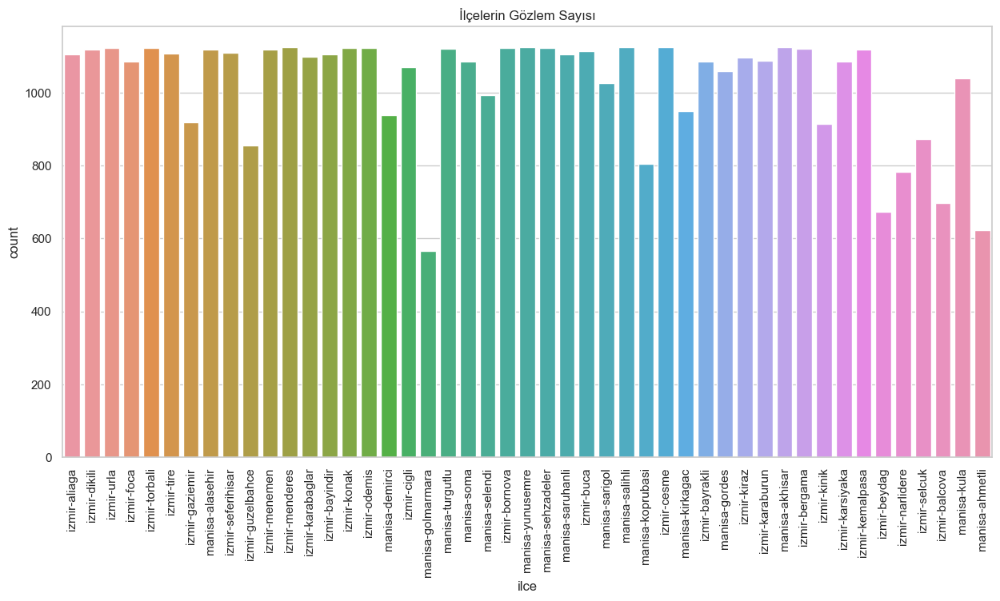

ilk 15 ilçe
 ilce
manisa-salihli       1126
manisa-akhisar       1126
manisa-yunusemre     1125
izmir-cesme          1125
izmir-menderes       1125
izmir-bornova        1124
izmir-konak          1124
izmir-torbali        1124
izmir-odemis         1124
manisa-sehzadeler    1123
izmir-urla           1122
manisa-turgutlu      1121
izmir-bergama        1120
manisa-alasehir      1119
izmir-menemen        1119
Name: count, dtype: int64


In [20]:
fig,ax=plt.subplots(figsize=(15,7))
sns.countplot(df,x="ilce")
plt.title("İlçelerin Gözlem Sayısı")
plt.xticks(rotation=90)
plt.show()
ilce_vc=df.value_counts("ilce")
print("ilk 15 ilçe\n",ilce_vc[:15])

In [21]:
min(test["tarih"])-min(train["tarih"])

Timedelta('1126 days 00:00:00')

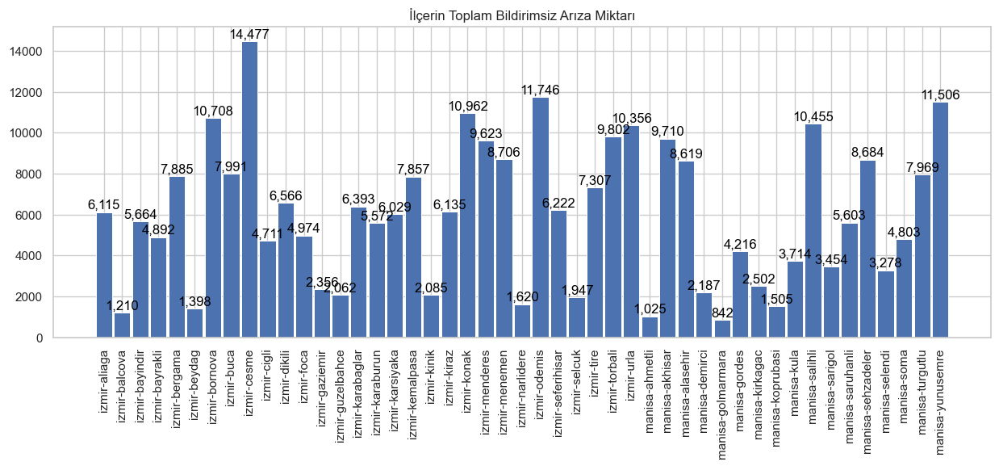

In [22]:
ilce_toplam_kesinti=df.groupby("ilce")["bildirimsiz_sum"].sum()
ilce_toplam_kesinti=pd.DataFrame(ilce_toplam_kesinti)
ilce_toplam_kesinti.reset_index(inplace=True)
ilce_toplam_kesinti.columns=["ilce","toplam"]
fig, ax = plt.subplots(figsize=(15,5))
bar_container = ax.bar(ilce_toplam_kesinti["ilce"], ilce_toplam_kesinti["toplam"], width=0.9, edgecolor="white", linewidth=0.7)
ax.bar_label(bar_container, fmt='{:,.0f}', color="black", padding=0.9)
plt.title("İlçerin Toplam Bildirimsiz Arıza Miktarı")
plt.xticks(rotation=90)
plt.show()

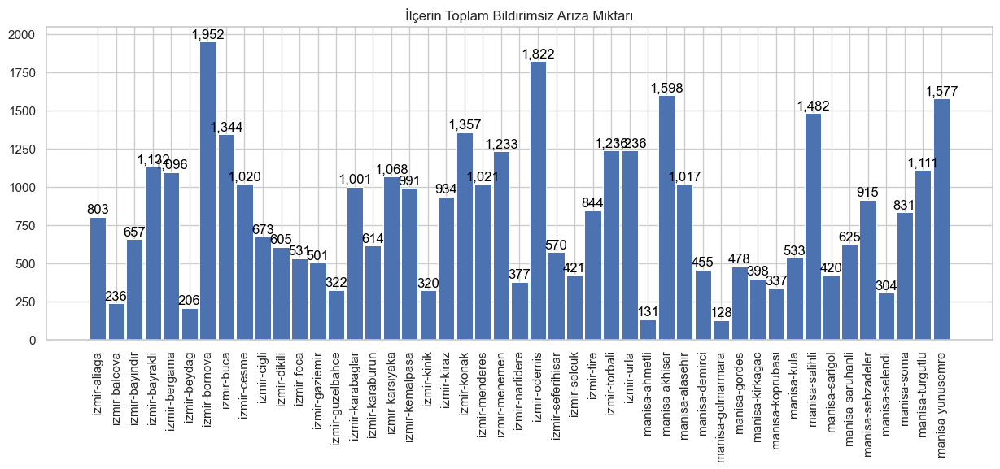

In [23]:
ilce_toplam_kesinti=df.groupby("ilce")["bildirimli_sum"].sum()
ilce_toplam_kesinti=pd.DataFrame(ilce_toplam_kesinti)
ilce_toplam_kesinti.reset_index(inplace=True)
ilce_toplam_kesinti.columns=["ilce","toplam"]
fig, ax = plt.subplots(figsize=(15,5))
bar_container = ax.bar(ilce_toplam_kesinti["ilce"], ilce_toplam_kesinti["toplam"], width=0.9, edgecolor="white", linewidth=0.7)
ax.bar_label(bar_container, fmt='{:,.0f}', color="black", padding=0.9)
plt.title("İlçerin Toplam Bildirimsiz Arıza Miktarı")
plt.xticks(rotation=90)
plt.show()

In [24]:
# Eksik gözlem birimine sahip ilçeleri bildirimli ve bildirimsiz sum sutunlarına 0 değeri atayarak yeni veri setimizi oluşturuyoruz.
ilceler=df["ilce"].unique()
new_train=pd.DataFrame()
end_date=df["tarih"].max()
for i in ilceler:
    df_start = df[df["ilce"]==i]["tarih"].min()
    df_end = df[df["ilce"]==i]["tarih"].max()
    date_range = pd.date_range(start=df_start, end=end_date)
    dates_missing = date_range.difference(df[df["ilce"]==i]["tarih"])
    if len(dates_missing)>0:
        data=pd.DataFrame(pd.date_range(start=df_start, end=end_date),columns=["tarih"])
        data=pd.merge(data,df[df["ilce"]==i],how="left",on="tarih")
        data["bildirimsiz_sum"].fillna(0,inplace=True)
        data["bildirimli_sum"].fillna(0,inplace=True)
        data["ilce"].ffill(inplace=True)
    else:
        data=df[df["ilce"]==i]
    new_train=pd.concat([new_train,data],axis=0,ignore_index=True)
new_train.sort_values(by="tarih",inplace=True)
df=new_train

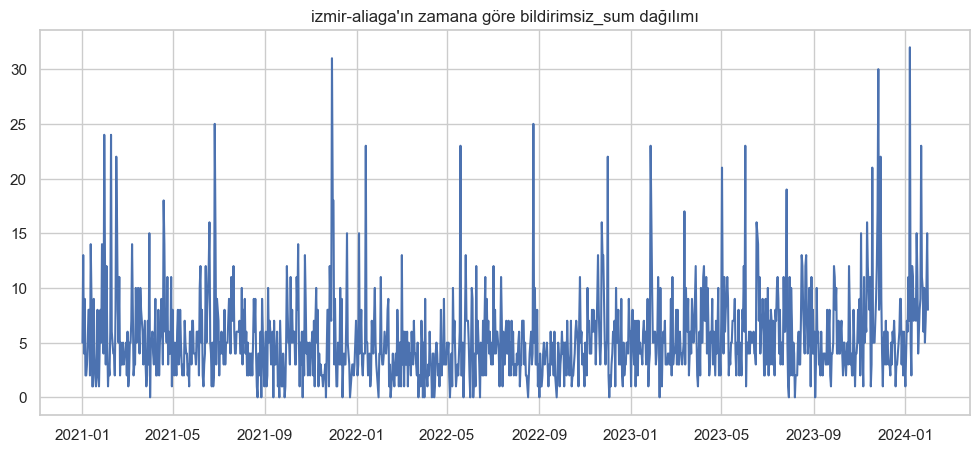

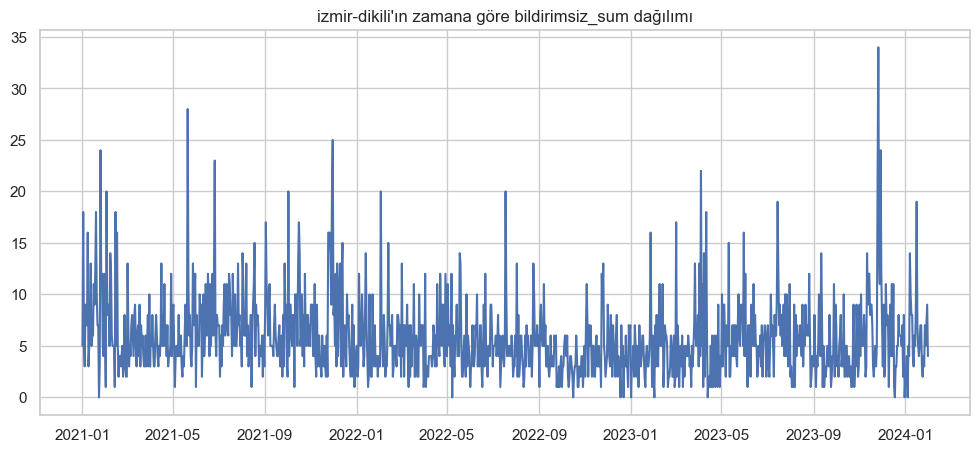

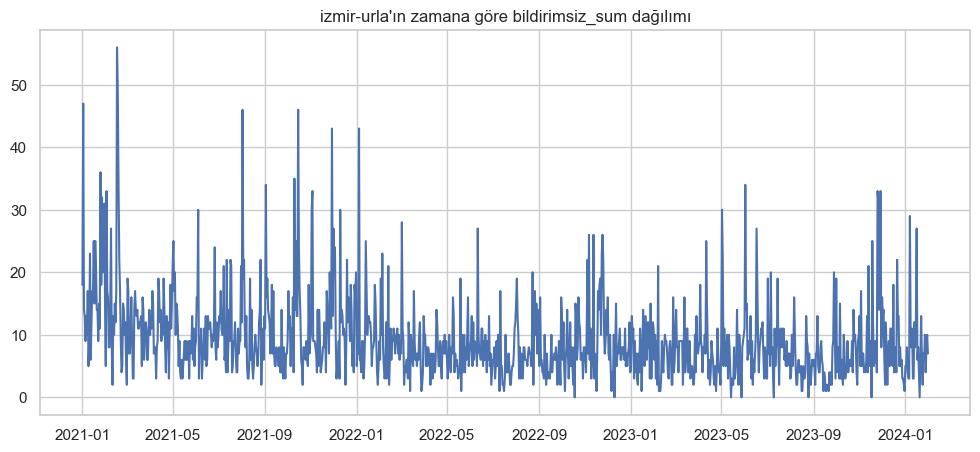

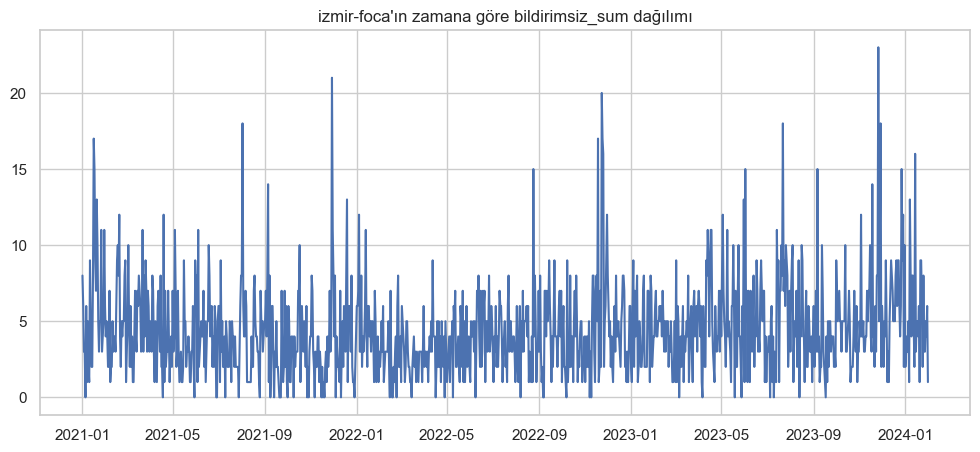

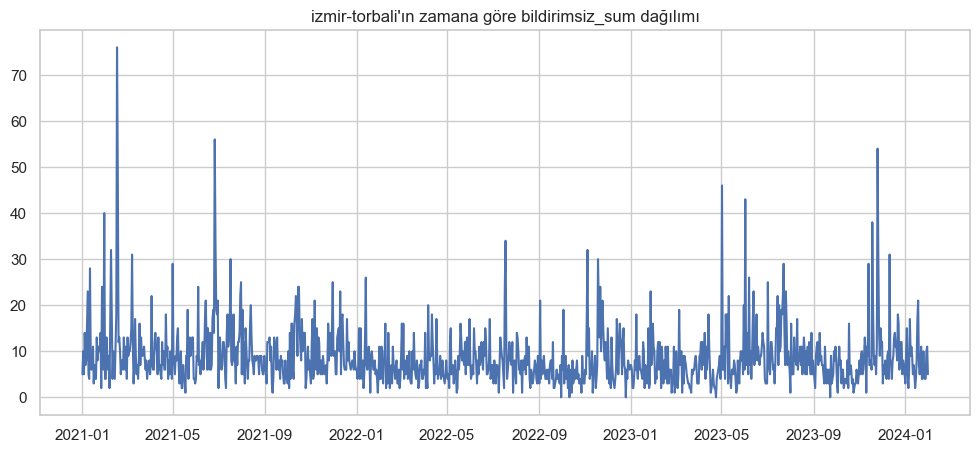

...

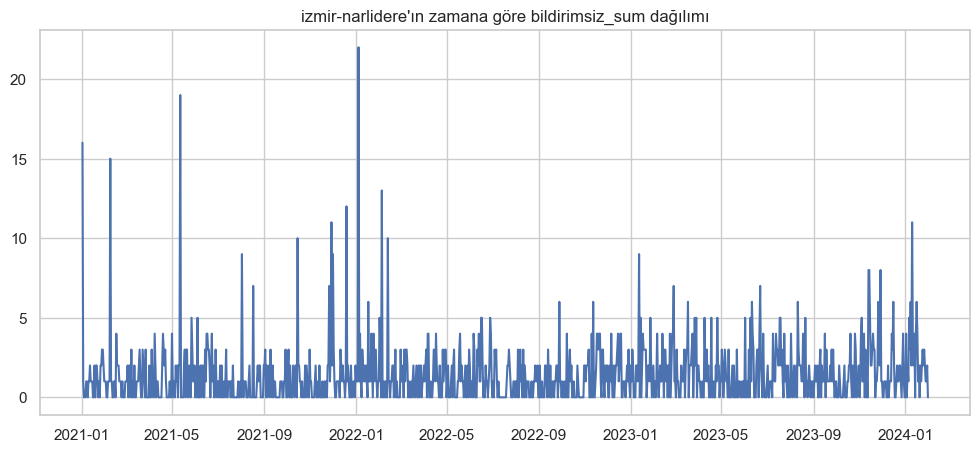

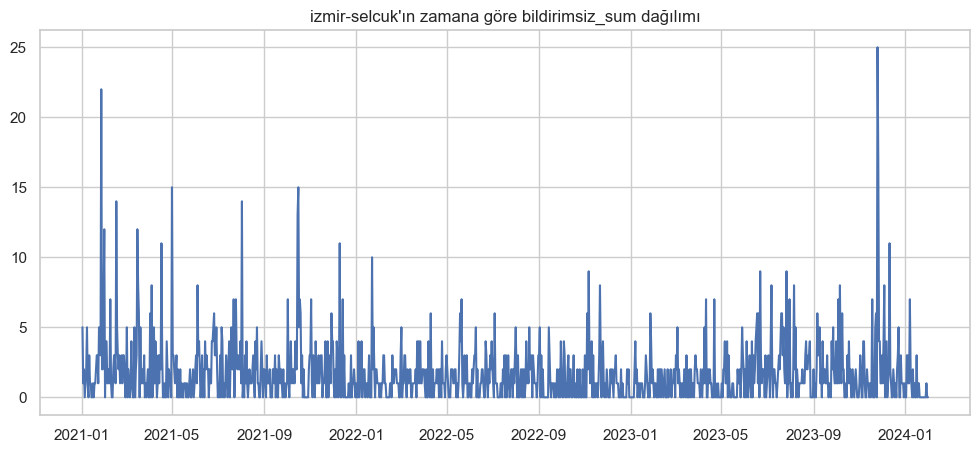

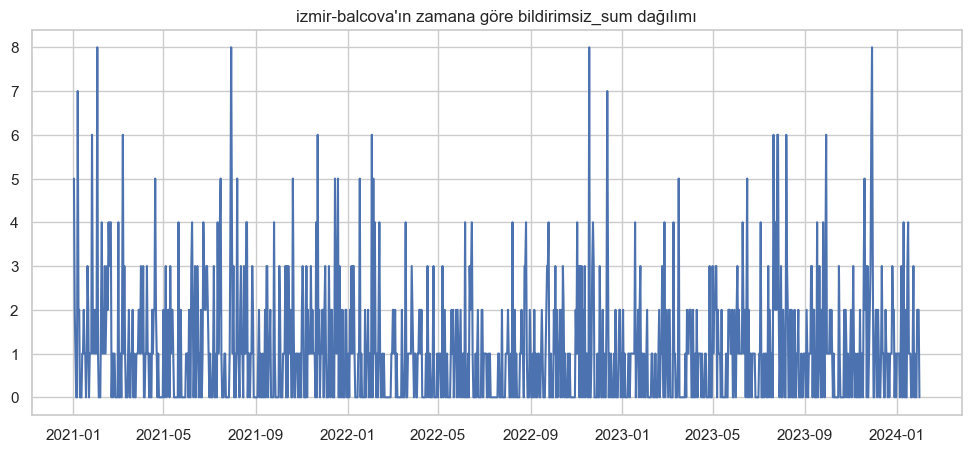

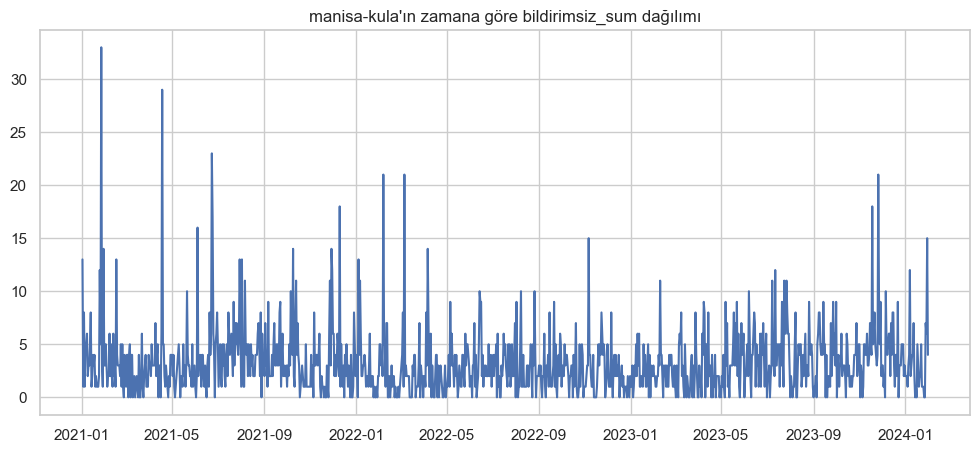

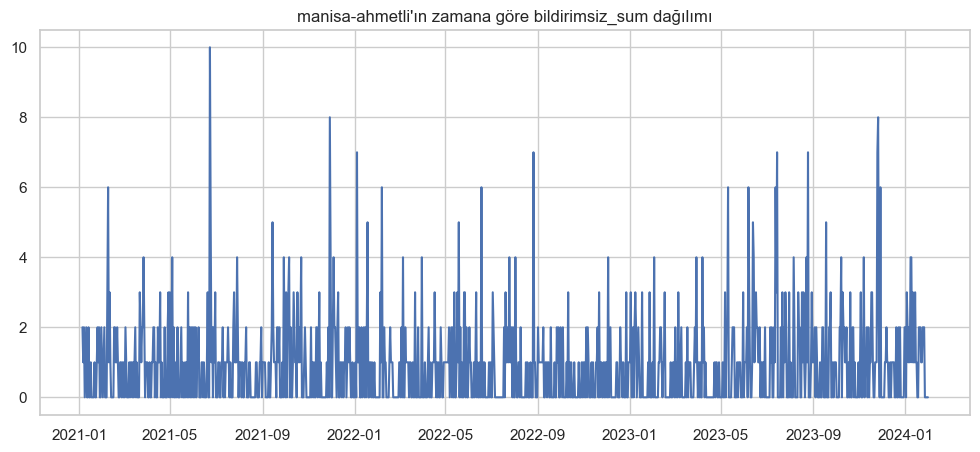

In [25]:
def ilce_kesinti_dagilim(df,ilce,aranacak_kolon):
    data=df[df["ilce"]==ilce]
    fig, ax=plt.subplots(figsize=(12,5))
    ax.plot(data["tarih"],data[aranacak_kolon])
    plt.title(f"{ilce}'ın zamana göre {aranacak_kolon} dağılımı")
    plt.show()

for i in ilceler:
    ilce_kesinti_dagilim(df,i,"bildirimsiz_sum")

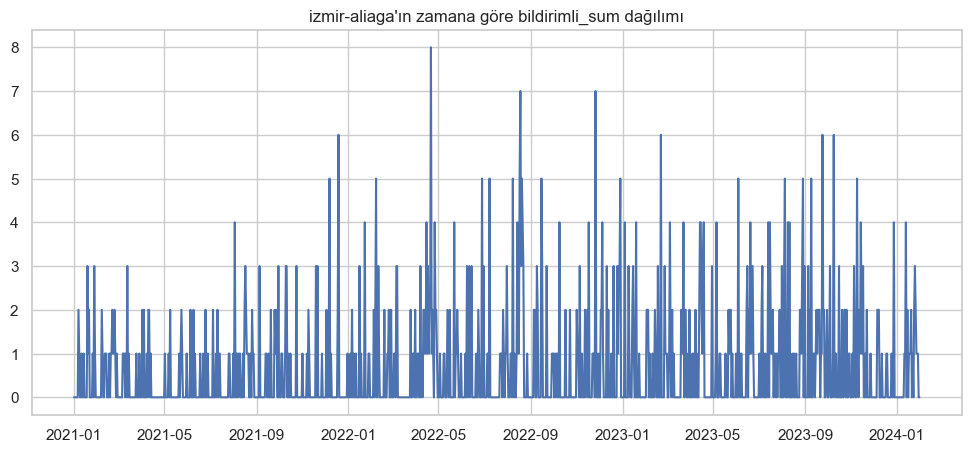

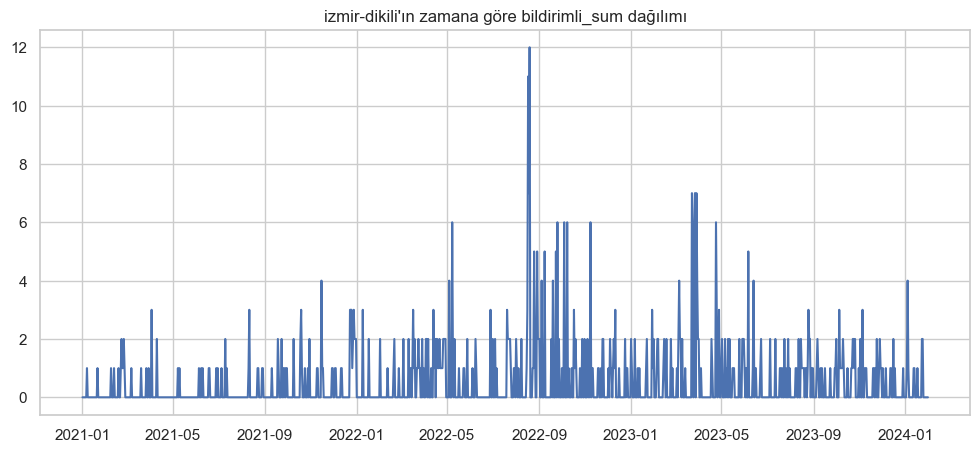

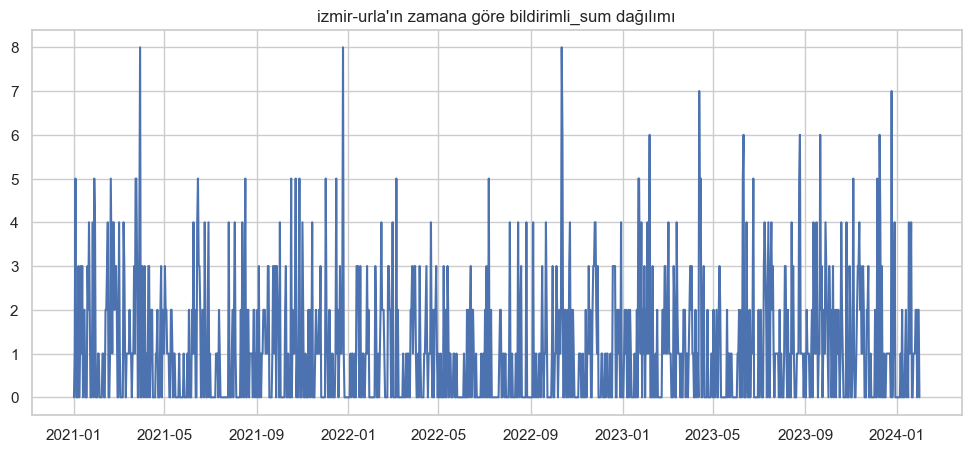

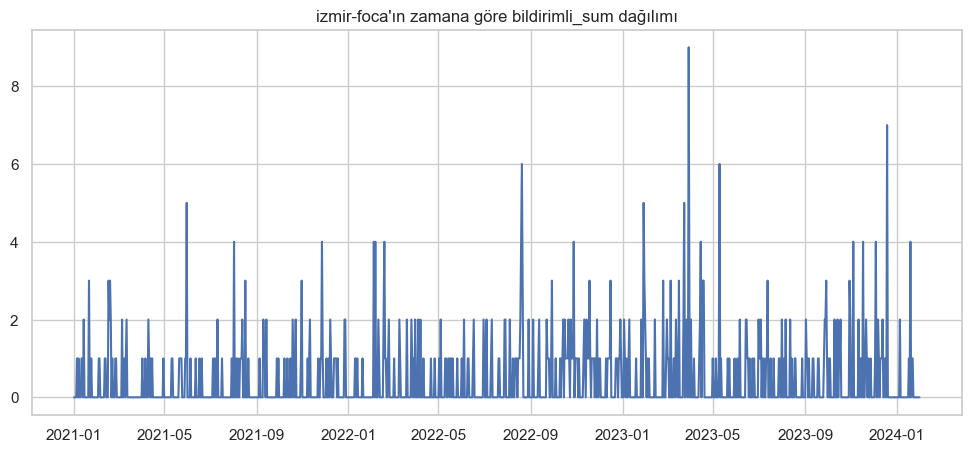

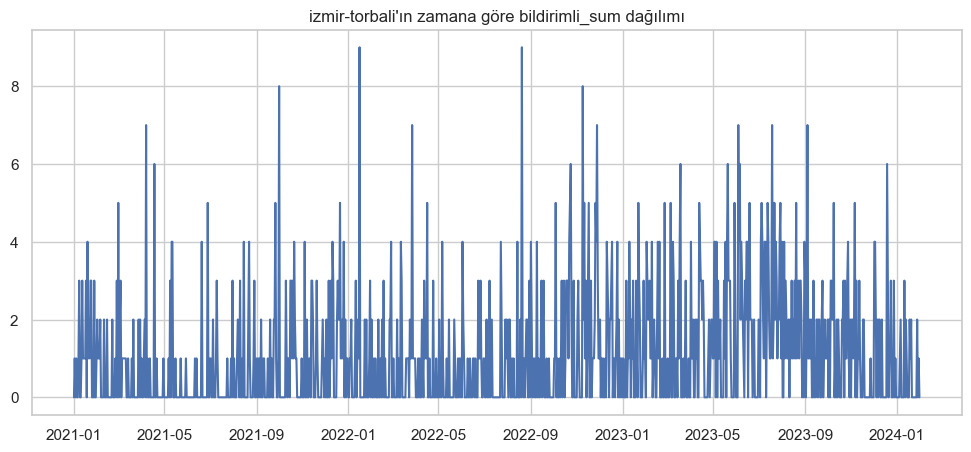

...

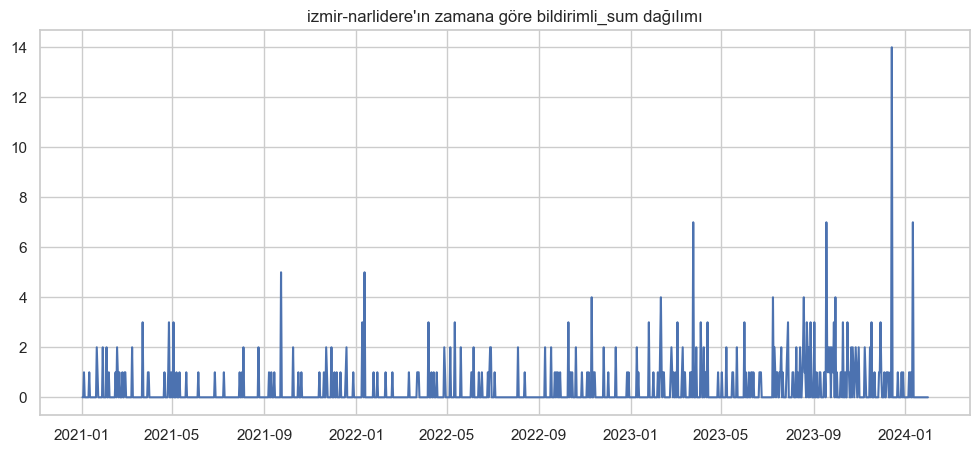

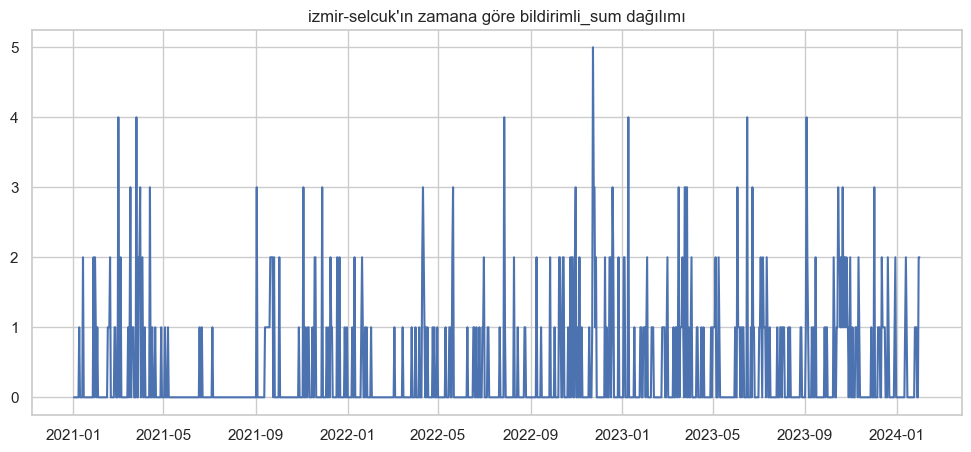

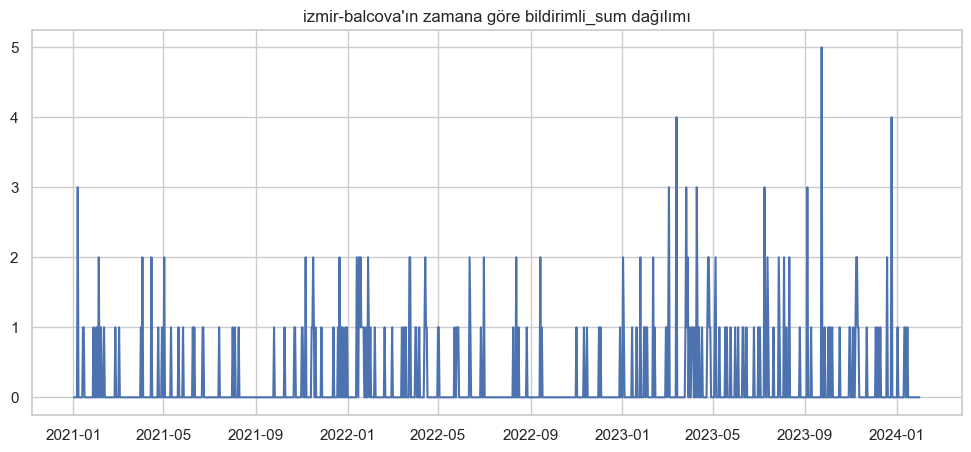

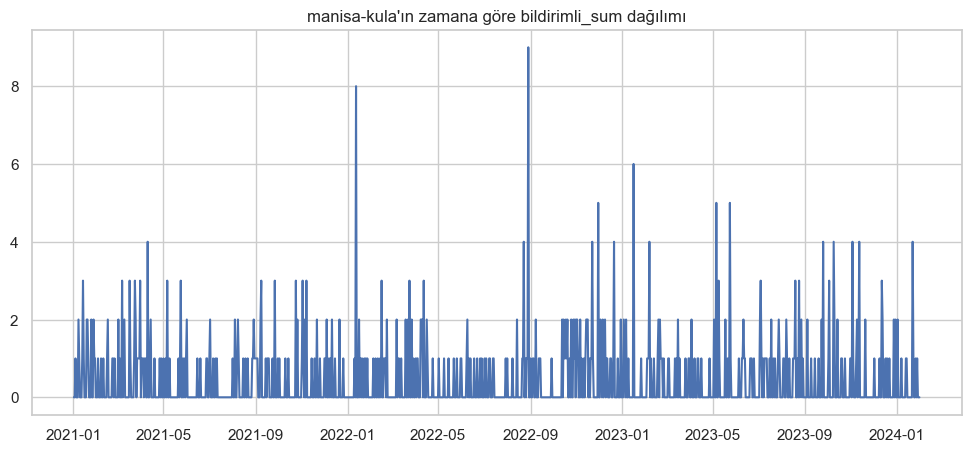

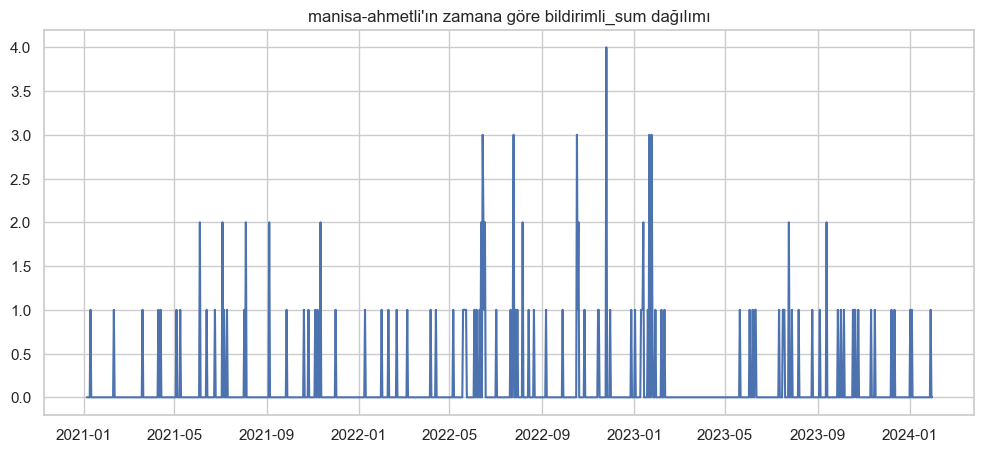

In [26]:
for i in ilceler:
    ilce_kesinti_dagilim(df,i,"bildirimli_sum")

In [27]:
# Yıl, ay, gün ve mevsim bazlı analiz yapabilmek ve eğitim modelde kullanabilmek için tarih değişkeninden yil, ay ,gün, mevsim değişkenlerini
# türetiyoruz. Mevsim değişkeninde hava olaylarını gözlemleyebilmek için bilinen dört mevsime göre aldım.
df["yil"]=df["tarih"].dt.year
df["ay"]=df["tarih"].dt.month
df["haftanin_gunu"]=df["tarih"].dt.dayofweek
df["mevsim"]=df["ay"].apply(lambda x: "kış" if x==1 or x==2 or x==12 else "ilkbahar" if  x==3 or x==4 or x==5 else "yaz" if  x==6 or x==7 or x==8 else "sonbahar")

In [28]:
def mevsimsel_degisim(mevsim,df,aranacak_kolon):
    mevsim_df=df[df["mevsim"]==mevsim]
    mevsim_df=pd.DataFrame(mevsim_df.groupby(["yil","tarih"])[aranacak_kolon].sum())
    mevsim_df.reset_index(inplace=True)
    mevsim_df.columns=["yil","tarih","toplam"]
    yil=mevsim_df["yil"].unique()
    fig, ax=plt.subplots(figsize=(10,5))
    for i in range(0,len(yil)):
        data=mevsim_df[mevsim_df["yil"]==yil[i]]
        x=np.arange(0,len(data))
        ax.plot(x,data["toplam"],label=yil[i])
    plt.title(f"{mevsim} mevsiminde yıllara göre {aranacak_kolon}'nın değişimi")
    plt.legend()
    plt.show()

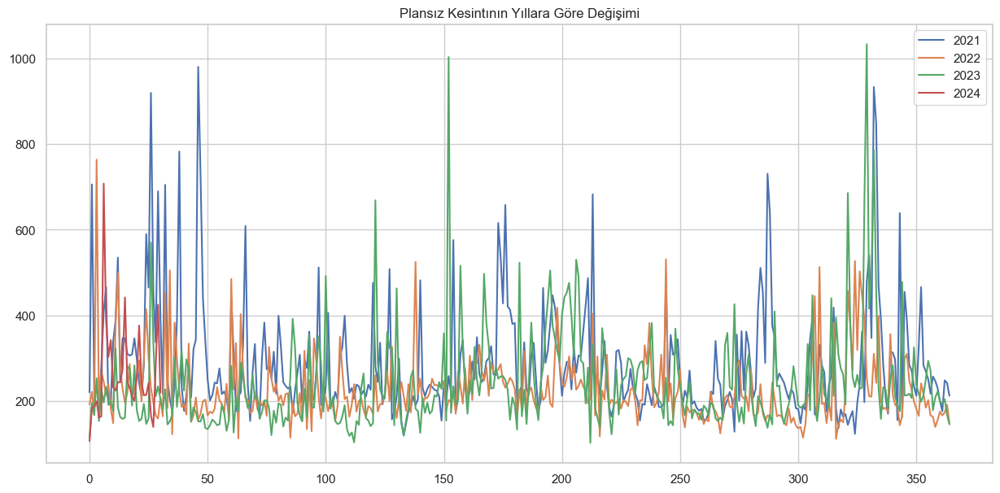

In [29]:
yil_df=df.groupby(["yil","tarih"])["bildirimsiz_sum"].sum()
yil_df=pd.DataFrame(yil_df)
yil_df.reset_index(inplace=True)
yil2021=yil_df[yil_df["yil"]==2021]
yil2022=yil_df[yil_df["yil"]==2022]
yil2023=yil_df[yil_df["yil"]==2023]
yil2024=yil_df[yil_df["yil"]==2024]
fig, ax=plt.subplots(figsize=(15,7))
ax.plot(np.arange(0,len(yil2021)),yil2021["bildirimsiz_sum"],label=2021)
ax.plot(np.arange(0,len(yil2022)),yil2022["bildirimsiz_sum"],label=2022)
ax.plot(np.arange(0,len(yil2023)),yil2023["bildirimsiz_sum"],label=2023)
ax.plot(np.arange(0,len(yil2024)),yil2024["bildirimsiz_sum"],label=2024)
plt.title("Plansız Kesintının Yıllara Göre Değişimi")
plt.legend()
plt.show()

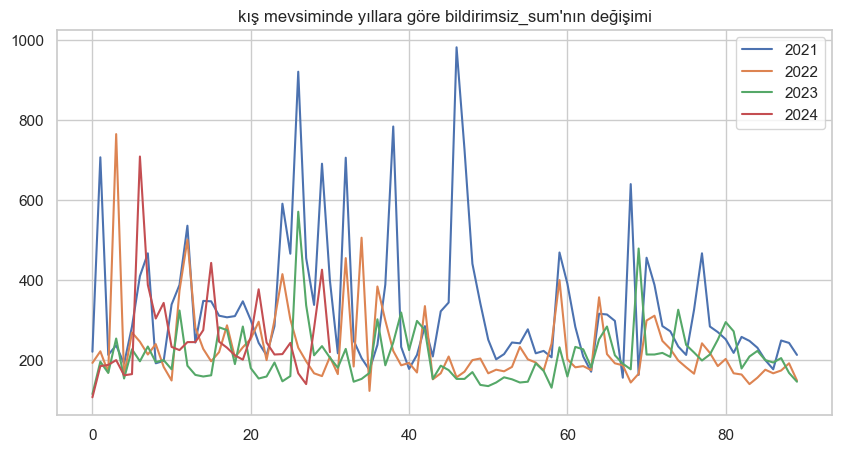

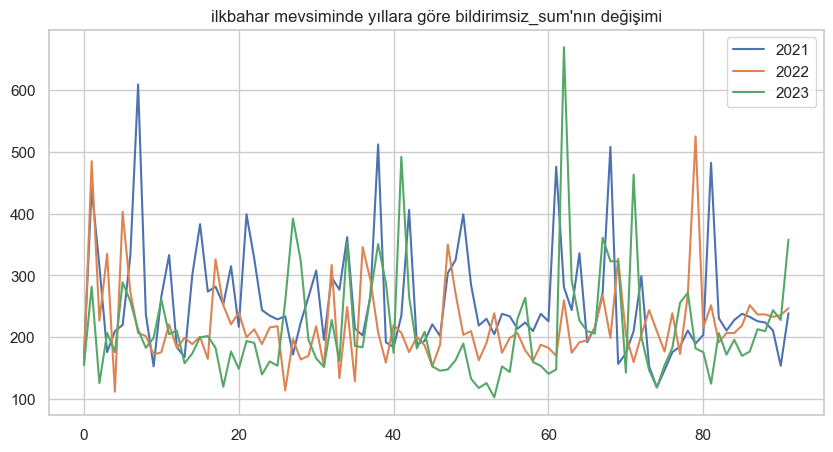

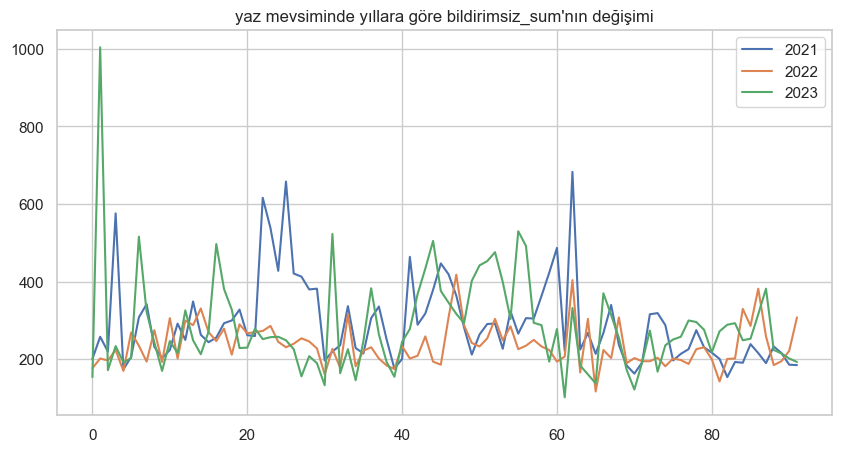

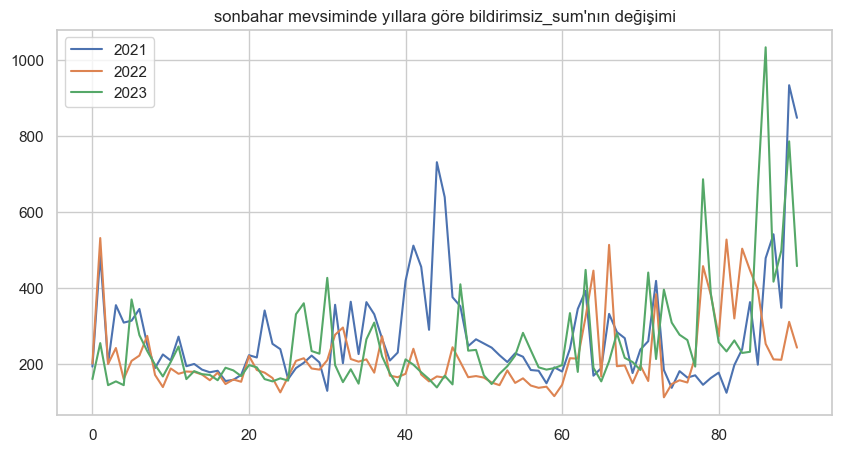

In [30]:
for i in ["kış","ilkbahar","yaz","sonbahar"]:
    mevsimsel_degisim(i,df,"bildirimsiz_sum")

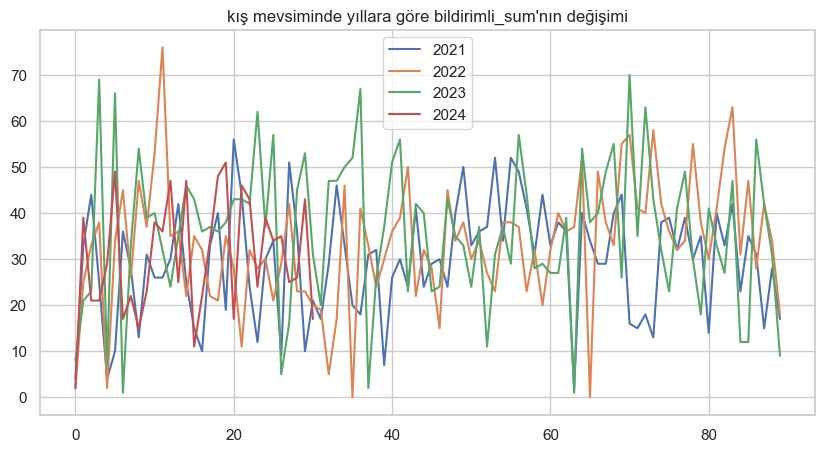

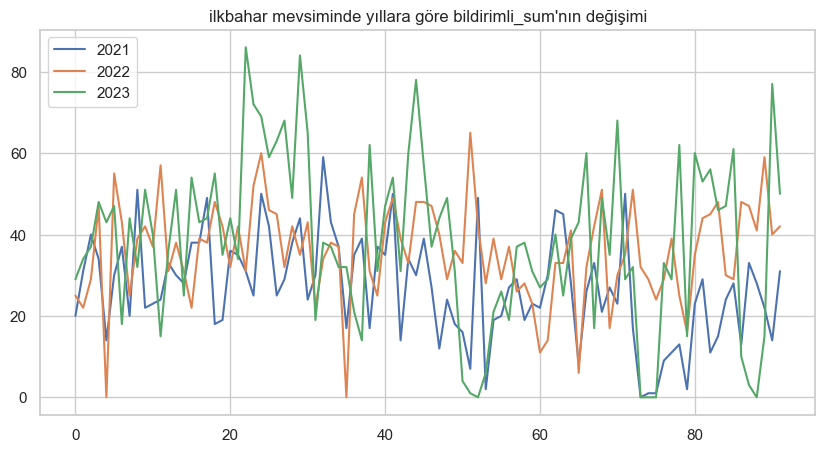

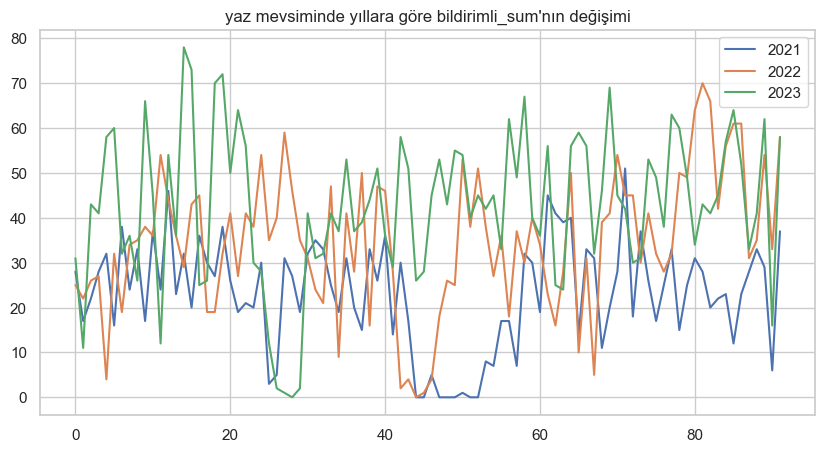

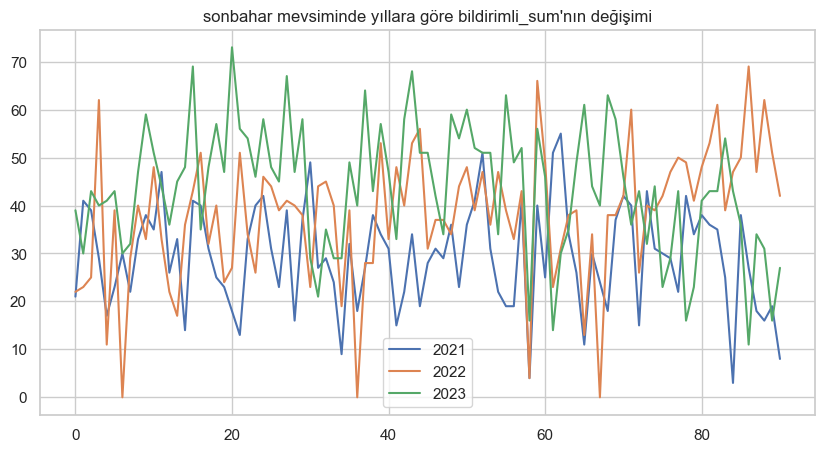

In [31]:
for i in ["kış","ilkbahar","yaz","sonbahar"]:
    mevsimsel_degisim(i,df,"bildirimli_sum")

In [32]:
def haftanin_gunlerine_gore_degisim(df,aranacak_kolon):
    gun=df.groupby("haftanin_gunu")[aranacak_kolon].sum()
    fig, ax=plt.subplots(figsize=(10,5))
    gun_isim=["Pazartesi","Salı","Çarşamba","Perşembe","Cuma","Cumartesi","Pazar"]
    ax.plot(gun_isim,gun,marker="+",markersize=10)
    plt.title(f"Haftanın günlerine göre toplam {aranacak_kolon}'ın dağılımı")
    plt.show()

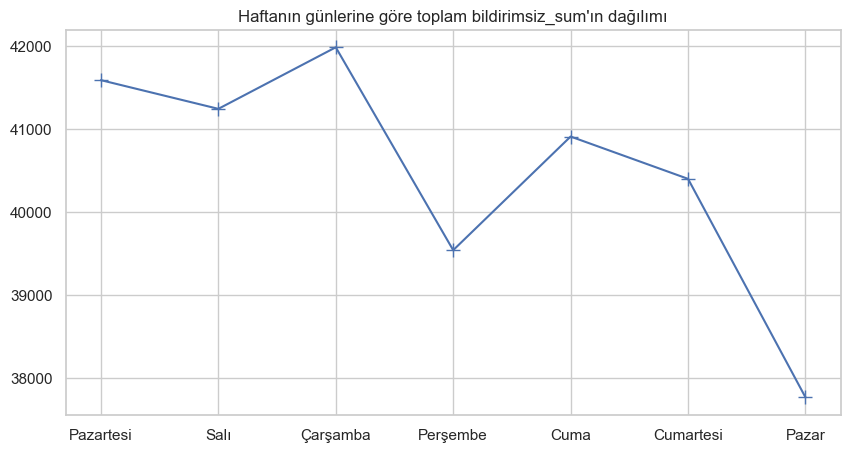

In [33]:
haftanin_gunlerine_gore_degisim(df,"bildirimsiz_sum")

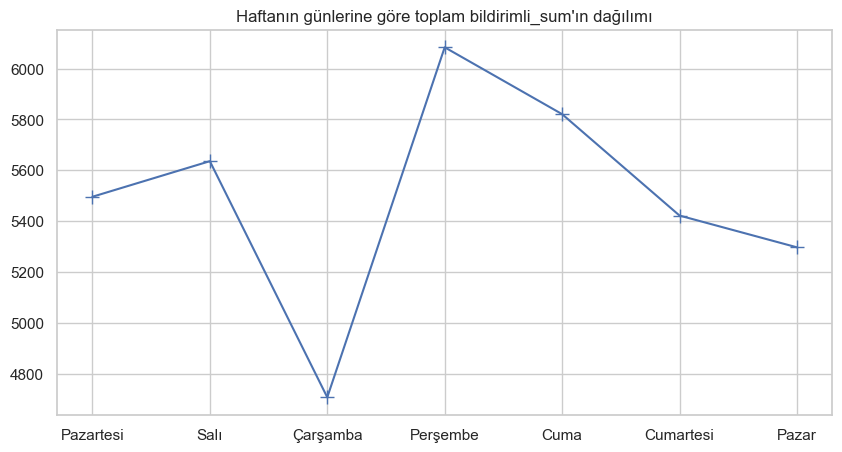

In [34]:
haftanin_gunlerine_gore_degisim(df,"bildirimli_sum")

In [35]:
# Bildrimli_sum değişkenine durağınlık testi yapıyoruz.
from statsmodels.tsa.stattools import adfuller
def adfuller_test(data):
    result=adfuller(data)
    if result[1] <= 0.05:
        return "Durağan"
    else:
        return "Durağan değil"
liste=[]
ilce=df.ilce.unique()
for i in ilce:
    data=df[df["ilce"]==i]
    data.reset_index(inplace=True)
    liste.append([i,adfuller_test(data["bildirimsiz_sum"])])
liste

[['izmir-aliaga', 'Durağan'],
 ['izmir-cesme', 'Durağan'],
 ['izmir-cigli', 'Durağan'],
 ['manisa-turgutlu', 'Durağan'],
 ['manisa-salihli', 'Durağan'],
 ['manisa-sarigol', 'Durağan'],
 ['manisa-soma', 'Durağan'],
 ['izmir-bornova', 'Durağan'],
 ['izmir-guzelbahce', 'Durağan'],
 ['manisa-saruhanli', 'Durağan'],
 ['izmir-konak', 'Durağan'],
 ['manisa-gordes', 'Durağan'],
 ['manisa-koprubasi', 'Durağan'],
 ['manisa-golmarmara', 'Durağan'],
 ['izmir-urla', 'Durağan'],
 ['izmir-bayindir', 'Durağan'],
 ['izmir-kiraz', 'Durağan'],
 ['izmir-gaziemir', 'Durağan'],
 ['manisa-akhisar', 'Durağan'],
 ['izmir-kinik', 'Durağan'],
 ['izmir-bergama', 'Durağan'],
 ['manisa-selendi', 'Durağan'],
 ['manisa-yunusemre', 'Durağan'],
 ['manisa-sehzadeler', 'Durağan'],
 ['izmir-seferihisar', 'Durağan'],
 ['izmir-karsiyaka', 'Durağan'],
 ['manisa-kirkagac', 'Durağan'],
 ['manisa-demirci', 'Durağan'],
 ['izmir-menemen', 'Durağan'],
 ['izmir-odemis', 'Durağan'],
 ['izmir-torbali', 'Durağan'],
 ['izmir-foca', 'Du

# Hava Durumu Verisinin İncelenmesi

In [36]:
display(weather.describe().T,weather.describe(include="O").T)

,count,mean,std,min,25%,50%,75%,max
lat,1302840.0,38.535130,0.303275,37.9508,38.3250,38.4710,38.7375,39.1881
lon,1302840.0,27.526583,0.634262,26.3032,27.0697,27.3818,27.9748,28.8693
t_2m:C,1302840.0,17.259831,8.752368,-12.6000,10.8000,16.7000,23.6000,44.8000
effective_cloud_cover:p,1302840.0,29.840105,34.489809,0.0000,0.0000,12.6000,53.7000,100.0000
global_rad:W,1302840.0,200.391671,279.391289,0.0000,0.0000,0.0000,375.9000,1026.3000
relative_humidity_2m:p,1302840.0,64.028995,20.454085,5.6000,49.3000,66.2000,80.4000,100.0000
wind_dir_10m:d,1302840.0,158.169187,120.143999,0.0000,42.4000,141.4000,278.9000,360.0000
wind_speed_10m:ms,1302840.0,2.722684,1.916292,0.0000,1.3000,2.2000,3.7000,18.4000
prob_precip_1h:p,1302840.0,3.097589,11.094187,1.0000,1.0000,1.0000,1.0000,95.0000
t_apparent:C,1302840.0,18.452245,10.341129,-17.8000,11.4000,17.9000,25.2000,52.0000


,count,unique,top,freq
date,1302840,27720,2021-01-01 00:00:00,47
ilce,1302840,47,manisa-ahmetli,27720


In [37]:
weather["tarih"]=weather["date"].apply(lambda x: x[:10])
weather["tarih"]=pd.to_datetime(weather['tarih'])

tarih=[]
ilce=[]
min_sicaklik=[]
mak_sicaklik=[]
ort_sicaklik=[]
sicaklik_farki=[]
guneslilik_degeri=[]
nem_orani=[]
ruzgar_hizi=[]
yagis_orani=[]
hissedilen_min_sicaklik=[]
hissedilen_mak_sicaklik=[]
hissedilen_ort_sicaklik=[]
hissedilen_sicaklik_farki=[]

ilceler=weather["ilce"].unique()
tarihler=weather["tarih"].unique()
for i in ilceler:
    ilce_data=weather[weather["ilce"]==i]    
    for j in tarihler:
        gunluk_veri=ilce_data[ilce_data["tarih"]==j]
        tarih.append(j)
        ilce.append(i)
        min_sicaklik.append(gunluk_veri["t_2m:C"].min())
        mak_sicaklik.append(gunluk_veri["t_2m:C"].max())
        ort_sicaklik.append((gunluk_veri["t_2m:C"]).mean())
        sicaklik_farki.append(gunluk_veri["t_2m:C"].max()-gunluk_veri["t_2m:C"].min())
        guneslilik_degeri.append(gunluk_veri["global_rad:W"].max())
        nem_orani.append(gunluk_veri["relative_humidity_2m:p"].max())
        ruzgar_hizi.append(gunluk_veri["wind_speed_10m:ms"].max())
        yagis_orani.append(gunluk_veri["prob_precip_1h:p"].max())
        hissedilen_min_sicaklik.append(gunluk_veri["t_apparent:C"].min())
        hissedilen_mak_sicaklik.append(gunluk_veri["t_apparent:C"].max())
        hissedilen_ort_sicaklik.append((gunluk_veri["t_apparent:C"]).mean())
        hissedilen_sicaklik_farki.append(gunluk_veri["t_apparent:C"].max()-gunluk_veri["t_apparent:C"].min())

columns=["tarih","ilce","min_t_2m:C","max_t_2m:C","mean_t_2m:C","t_difference_2m:C","max_global_rad:W","max_relative_humidity_2m:p",
         "max_wind_speed_10m:ms","max_prob_precip_1h:p","min_t_apparent:C","max_t_apparent:C","mean_t_apparent:C","t_apparent_difference:C"]

new_weather=pd.DataFrame(columns=columns)
new_weather["tarih"]=tarih
new_weather["ilce"]=ilce
new_weather["min_t_2m:C"]=min_sicaklik
new_weather["max_t_2m:C"]=mak_sicaklik
new_weather["mean_t_2m:C"]=ort_sicaklik
new_weather["t_difference_2m:C"]=sicaklik_farki
new_weather["max_global_rad:W"]=guneslilik_degeri
new_weather["max_relative_humidity_2m:p"]=nem_orani
new_weather["max_wind_speed_10m:ms"]=ruzgar_hizi
new_weather["max_prob_precip_1h:p"]=yagis_orani
new_weather["min_t_apparent:C"]=hissedilen_min_sicaklik
new_weather["max_t_apparent:C"]=hissedilen_mak_sicaklik
new_weather["mean_t_apparent:C"]=hissedilen_ort_sicaklik
new_weather["t_apparent_difference:C"]=hissedilen_sicaklik_farki
new_weather.head()

,tarih,ilce,min_t_2m:C,max_t_2m:C,mean_t_2m:C,t_difference_2m:C,max_global_rad:W,max_relative_humidity_2m:p,max_wind_speed_10m:ms,max_prob_precip_1h:p,min_t_apparent:C,max_t_apparent:C,mean_t_apparent:C,t_apparent_difference:C
0,2021-01-01,manisa-ahmetli,5.9,12.8,8.941667,6.9,279.3,96.1,3.7,3.1,4.8,15.1,8.712500,10.3
1,2021-01-02,manisa-ahmetli,3.8,15.1,8.320833,11.3,473.0,96.4,2.2,1.0,2.2,18.1,8.412500,15.9
2,2021-01-03,manisa-ahmetli,2.8,13.2,7.750000,10.4,274.8,88.3,2.0,4.5,0.9,15.1,7.625000,14.2
3,2021-01-04,manisa-ahmetli,3.2,16.0,8.754167,12.8,478.8,91.1,3.2,7.4,1.2,18.0,8.333333,16.8
4,2021-01-05,manisa-ahmetli,6.1,13.8,9.850000,7.7,424.2,96.5,3.6,12.9,5.3,16.9,9.916667,11.6


In [38]:
new_weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54285 entries, 0 to 54284
Data columns (total 14 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   tarih                       54285 non-null  datetime64[ns]
 1   ilce                        54285 non-null  object        
 2   min_t_2m:C                  54285 non-null  float64       
 3   max_t_2m:C                  54285 non-null  float64       
 4   mean_t_2m:C                 54285 non-null  float64       
 5   t_difference_2m:C           54285 non-null  float64       
 6   max_global_rad:W            54285 non-null  float64       
 7   max_relative_humidity_2m:p  54285 non-null  float64       
 8   max_wind_speed_10m:ms       54285 non-null  float64       
 9   max_prob_precip_1h:p        54285 non-null  float64       
 10  min_t_apparent:C            54285 non-null  float64       
 11  max_t_apparent:C            54285 non-null  float64   

In [39]:
new_weather["tarih"]=pd.to_datetime(new_weather["tarih"])

In [40]:
new_weather.describe().T

,count,mean,min,25%,50%,75%,max,std
tarih,54285,2022-08-01 00:00:00,2021-01-01 00:00:00,2021-10-16 00:00:00,2022-08-01 00:00:00,2023-05-17 00:00:00,2024-02-29 00:00:00,NaN
min_t_2m:C,54285.0,12.743104,-12.6,7.3,12.7,18.8,29.4,7.271956
max_t_2m:C,54285.0,22.59883,-4.0,15.7,21.8,30.0,44.8,8.882667
mean_t_2m:C,54285.0,17.259831,-7.975,11.191667,16.716667,24.175,36.391667,8.004541
t_difference_2m:C,54285.0,9.855726,1.1,7.2,9.7,12.4,22.1,3.453906
max_global_rad:W,54285.0,669.534872,27.6,492.2,691.3,870.1,1026.3,222.835499
max_relative_humidity_2m:p,54285.0,83.608411,30.3,75.7,85.8,93.4,100.0,12.244652
max_wind_speed_10m:ms,54285.0,4.467181,0.7,3.0,4.2,5.6,18.4,1.987256
max_prob_precip_1h:p,54285.0,13.54341,1.0,1.0,1.0,5.5,95.0,27.058487
min_t_apparent:C,54285.0,12.4899,-17.8,6.3,12.8,19.5,29.3,8.334549


In [41]:
new_weather.describe(include="O").T

,count,unique,top,freq
ilce,54285,47,manisa-ahmetli,1155


# Tatil Verisinin İncelenmesi

In [42]:
holiday.head()

,Yıl,Ay,Gün,Tatil Adı
0,2021,1,1,New Year's Day
1,2021,4,23,National Sovereignty and Children's Day
2,2021,5,1,Labour Day
3,2021,5,19,"Commemoration of Ataturk, Youth and Sports Day"
4,2021,7,15,Democracy and National Unity Day


In [43]:
display(holiday.describe().T,holiday.describe(include="O").T)

,count,mean,std,min,25%,50%,75%,max
Yıl,55.0,2022.490909,1.136478,2021.0,2021.5,2022.0,2023.5,2024.0
Ay,55.0,5.727273,2.103388,1.0,5.0,6.0,7.0,10.0
Gün,55.0,16.090909,9.771979,1.0,10.0,17.0,23.0,30.0


,count,unique,top,freq
Tatil Adı,55,12,Sacrifice Feast Holiday* (*estimated),12


In [44]:
holiday["tarih"]=[str(holiday["Yıl"][i])+"-"+str(holiday["Ay"][i])+"-"+str(holiday["Gün"][i]) for i in range(0,len(holiday))]
holiday["tarih"]=pd.to_datetime(holiday["tarih"])
holiday["tatil_mi"]=np.ones(len(holiday))
# Test verisindeki tarih değikeni ay yıl ve gün ayrı verilmişti, bunları tabloları birleştirirken kullanmak için birleştirip yeni bir değişken
# olarak kullanamak için ekledik. Tatil günlerini belirmek için tatil mi değişkeni oluşturuldu.

In [45]:
holiday.head()

,Yıl,Ay,Gün,Tatil Adı,tarih,tatil_mi
0,2021,1,1,New Year's Day,2021-01-01,1.0
1,2021,4,23,National Sovereignty and Children's Day,2021-04-23,1.0
2,2021,5,1,Labour Day,2021-05-01,1.0
3,2021,5,19,"Commemoration of Ataturk, Youth and Sports Day",2021-05-19,1.0
4,2021,7,15,Democracy and National Unity Day,2021-07-15,1.0


# Verilerin Birleştirilmesi ve Analizi

In [46]:
df=pd.merge(df,new_weather,how="left",on=["tarih","ilce"])
tatil_df=holiday.drop(["Yıl","Ay","Gün","Tatil Adı"],axis=1)
df=pd.merge(df,tatil_df,how="left",on="tarih")
df.head()

,tarih,ilce,bildirimsiz_sum,bildirimli_sum,yil,ay,haftanin_gunu,mevsim,min_t_2m:C,max_t_2m:C,...,t_difference_2m:C,max_global_rad:W,max_relative_humidity_2m:p,max_wind_speed_10m:ms,max_prob_precip_1h:p,min_t_apparent:C,max_t_apparent:C,mean_t_apparent:C,t_apparent_difference:C,tatil_mi
0,2021-01-01,izmir-aliaga,5.0,0.0,2021,1,4,kış,11.3,15.8,...,4.5,338.4,91.8,6.4,1.0,11.5,18.6,13.929167,7.1,1.0
1,2021-01-01,izmir-cesme,10.0,0.0,2021,1,4,kış,13.2,17.0,...,3.8,426.1,88.8,8.5,1.0,13.3,19.9,15.379167,6.6,1.0
2,2021-01-01,izmir-cigli,1.0,0.0,2021,1,4,kış,11.3,15.9,...,4.6,341.9,91.6,5.7,6.7,11.5,19.0,13.995833,7.5,1.0
3,2021-01-01,manisa-turgutlu,4.0,0.0,2021,1,4,kış,9.3,15.7,...,6.4,330.5,92.2,3.6,3.1,9.3,18.3,13.104167,9.0,1.0
4,2021-01-01,manisa-salihli,5.0,0.0,2021,1,4,kış,8.7,16.0,...,7.3,311.6,90.4,1.5,1.0,8.3,19.4,12.558333,11.1,1.0


In [47]:
# Pazar günleri de ülkemizde resmi tatil sayıldığı için tatil günü olarak işaretlendi.
for i in range(0,len(df)):
    if df["haftanin_gunu"][i]==6:
        df["tatil_mi"][i]=1
df["tatil_mi"].fillna(0,inplace=True)

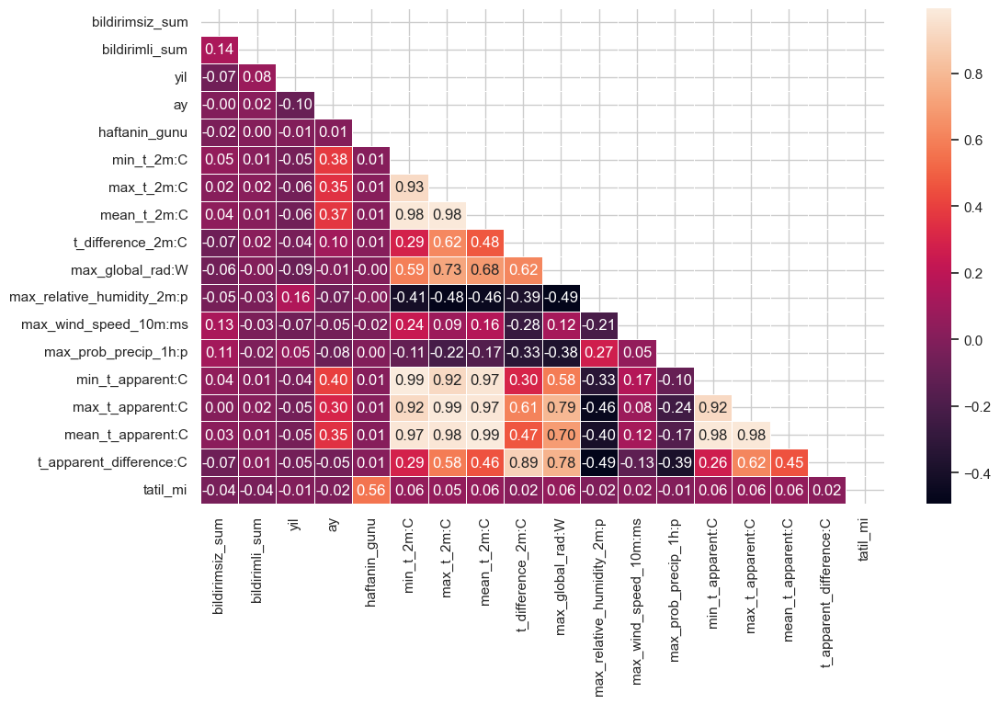

In [48]:
df_corr=df.corr(numeric_only=True)
mask = np.triu(np.ones_like(df_corr, dtype=bool))
plt.figure(figsize=(12,7))
sns.heatmap(df_corr,annot=True,fmt=".2f",linewidth=.5,mask=mask)
plt.show()

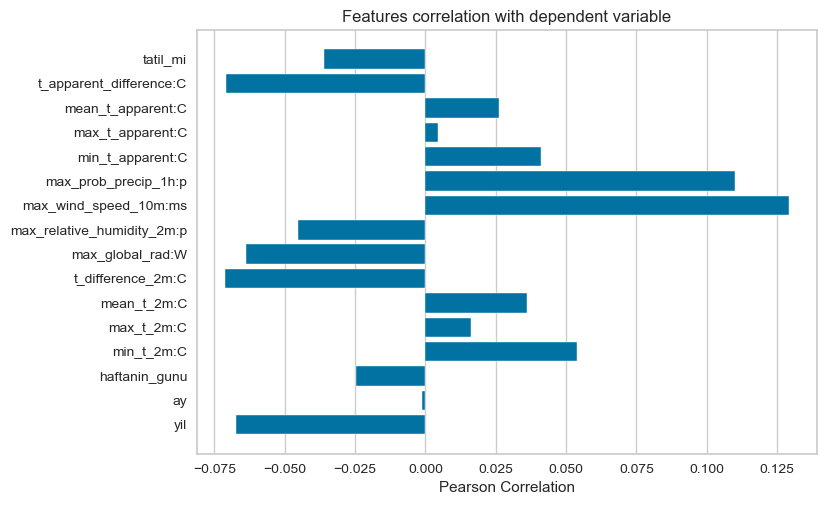

In [49]:
X = df.drop(['bildirimli_sum',"tarih","ilce","mevsim","bildirimsiz_sum"], axis=1)
y = df['bildirimsiz_sum']
from yellowbrick.target import FeatureCorrelation
visualizer = FeatureCorrelation(labels=X.columns)
visualizer.fit(X, y)
visualizer.show();

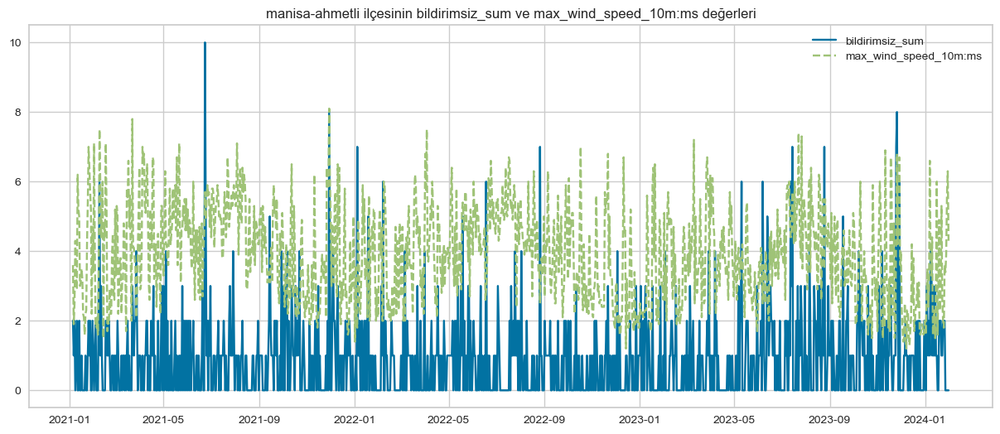

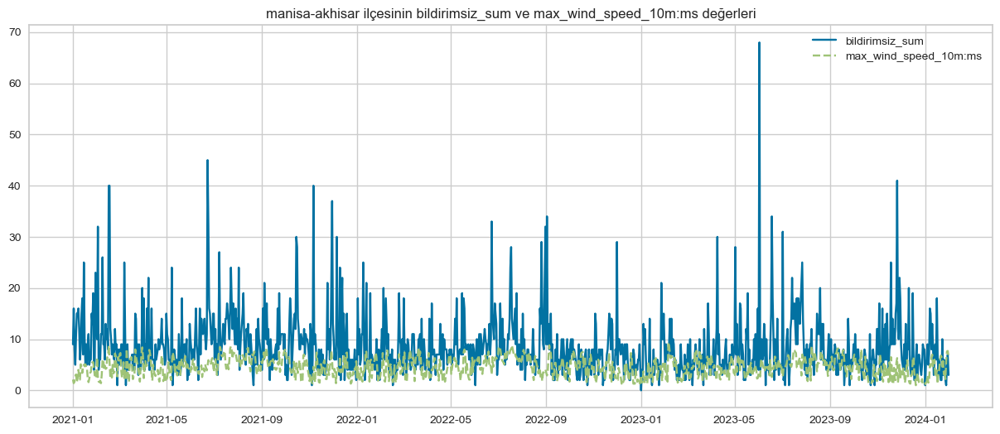

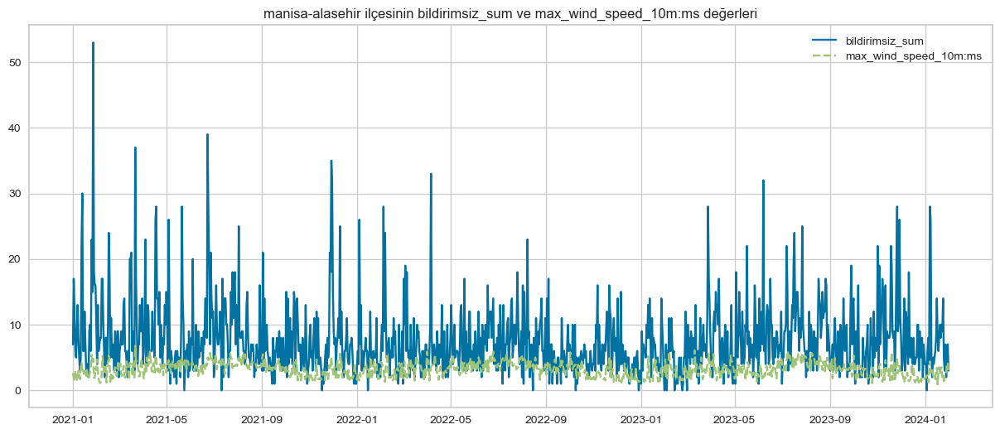

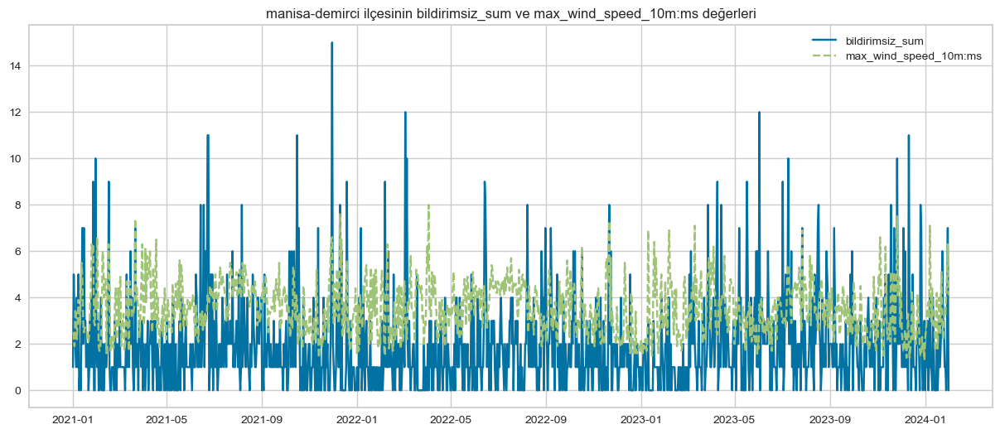

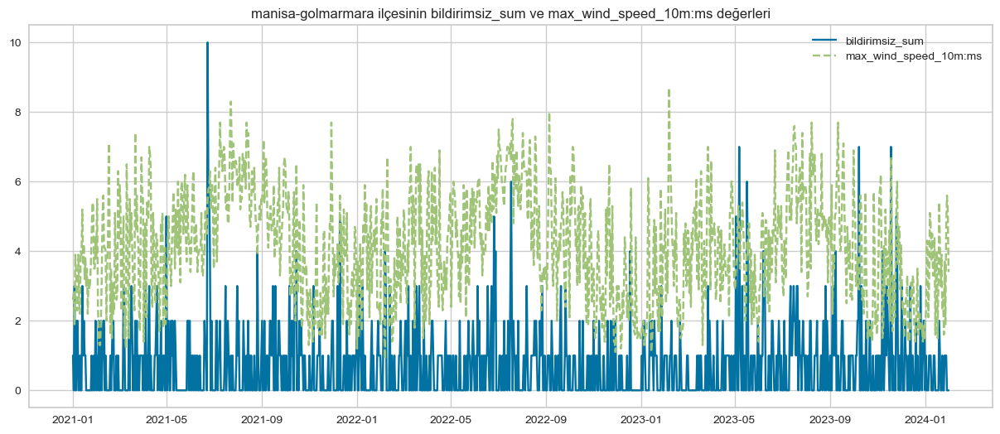

...

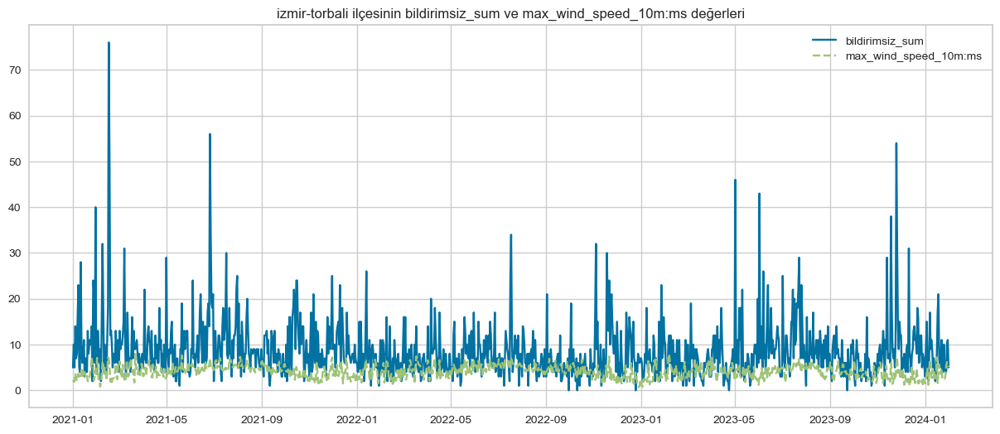

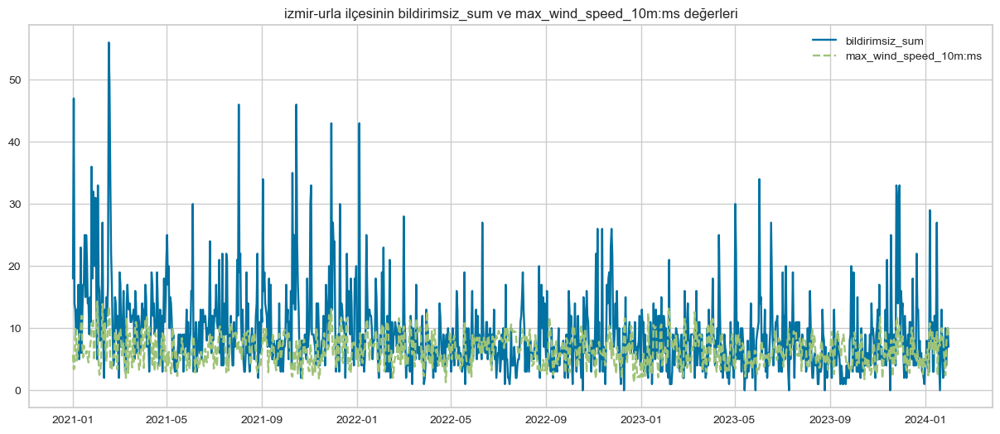

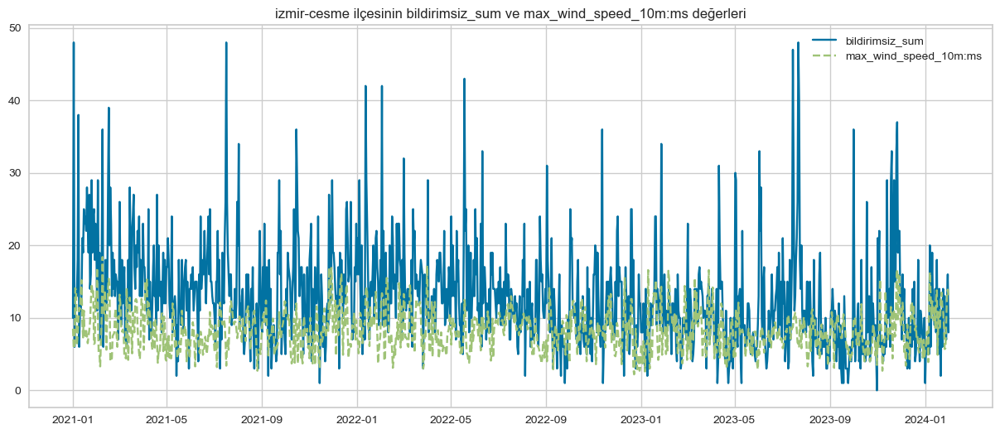

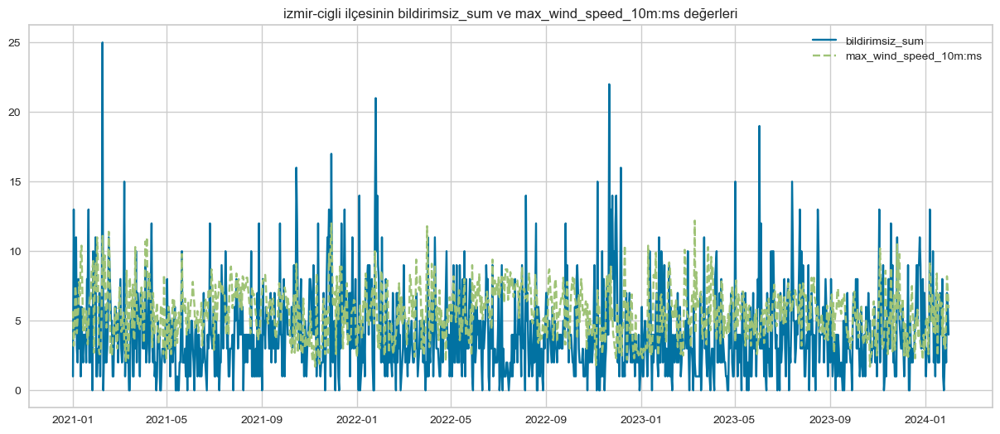

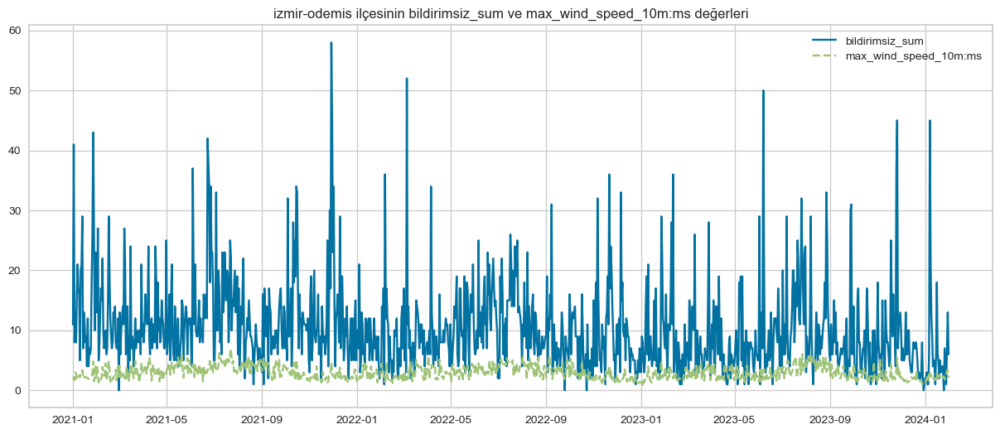

In [50]:
def ilce_hava_kesinti(df,ilce,kesinti_kolon,hava_kolon):
    ilce_data=df[df["ilce"]==ilce]
    f, ax = plt.subplots(figsize=(15, 6))
    ax.plot(ilce_data["tarih"],ilce_data[kesinti_kolon],label=kesinti_kolon)
    ax.plot(ilce_data["tarih"],ilce_data[hava_kolon],label=hava_kolon,linestyle="--")
    plt.title(f"{ilce} ilçesinin {kesinti_kolon} ve {hava_kolon} değerleri")
    plt.legend()
    plt.show()

for i in ilceler:
    ilce_hava_kesinti(df,i,"bildirimsiz_sum","max_wind_speed_10m:ms")

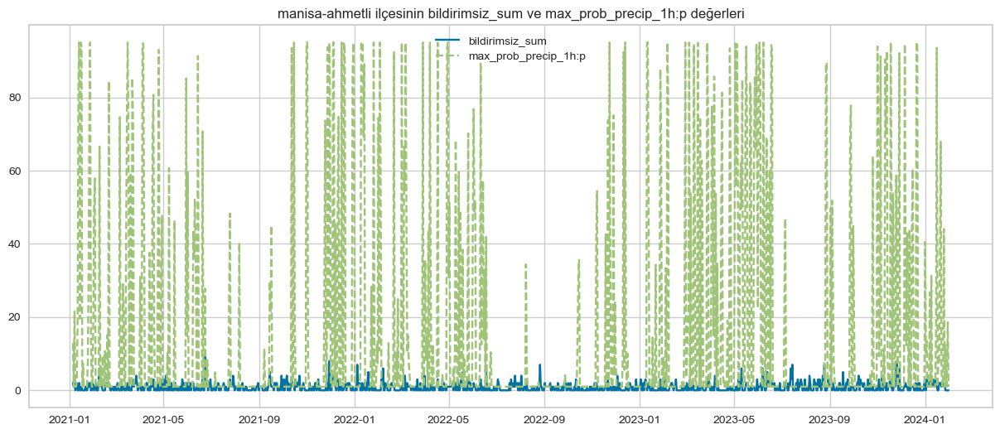

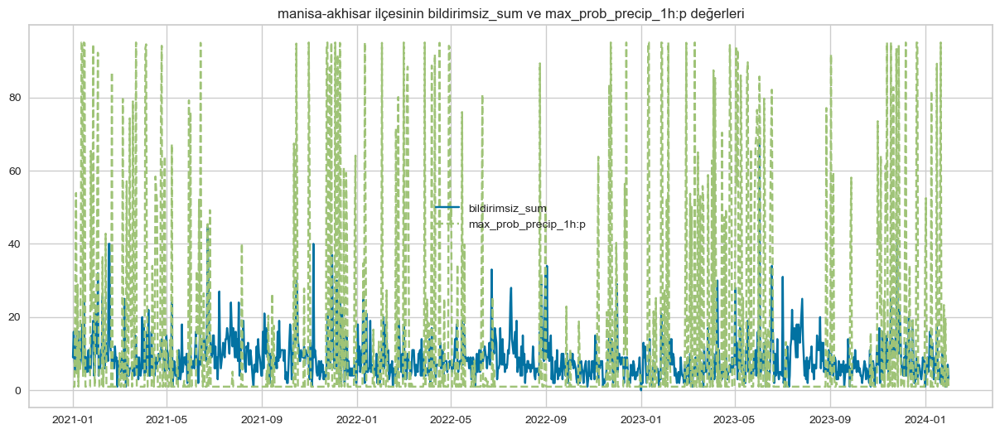

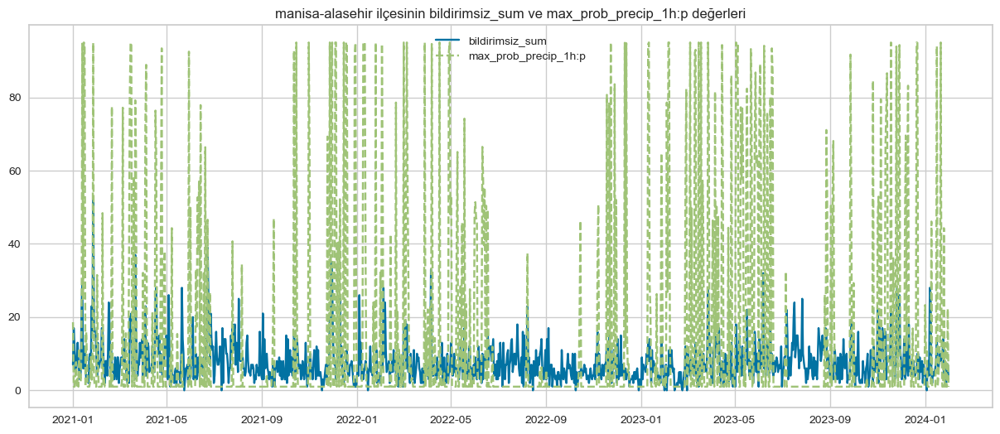

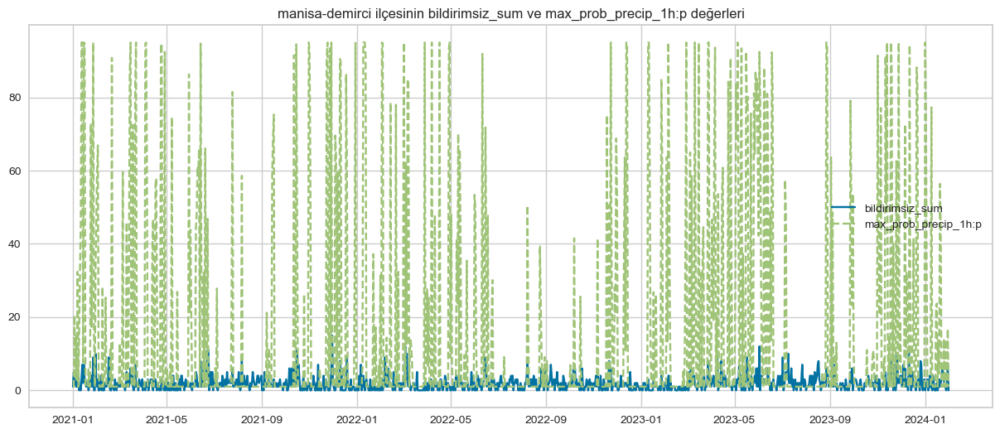

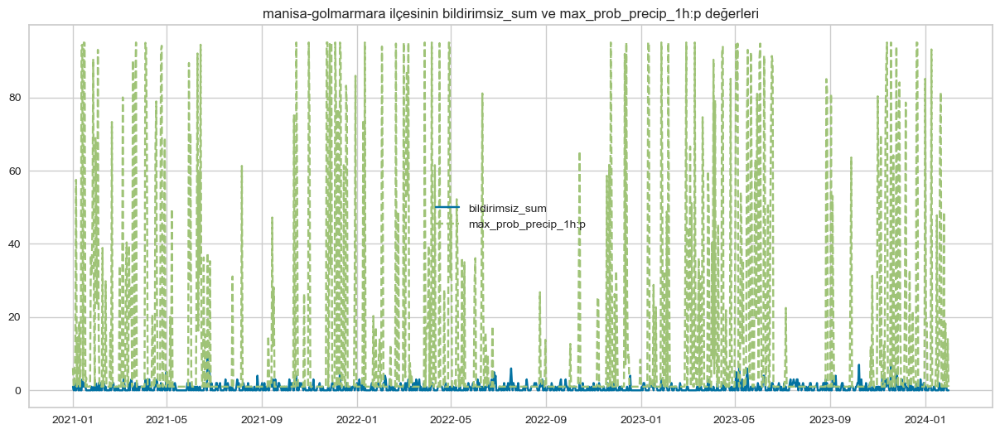

...

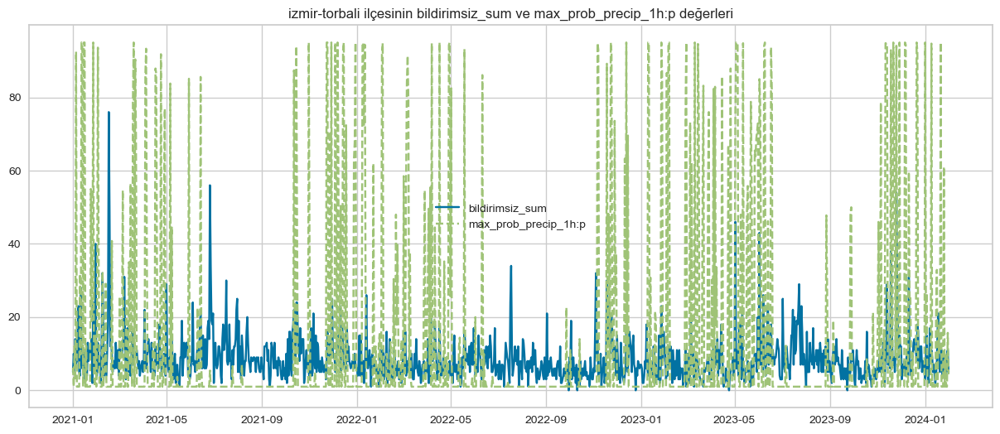

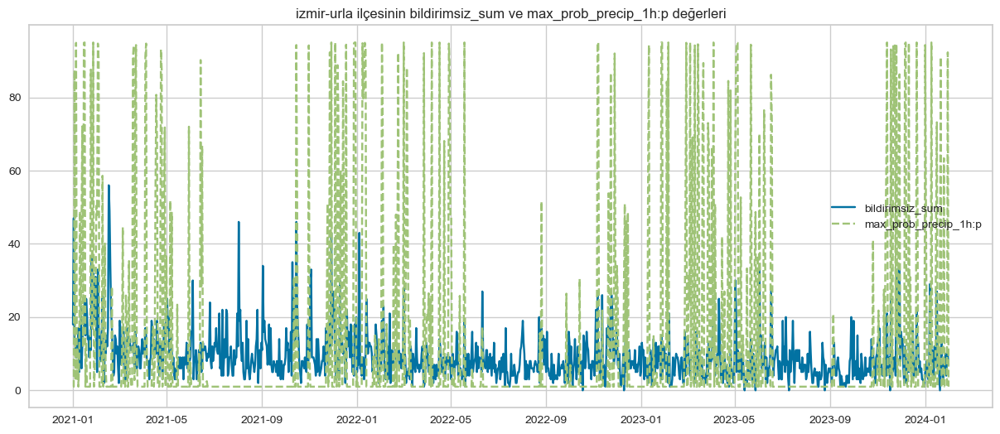

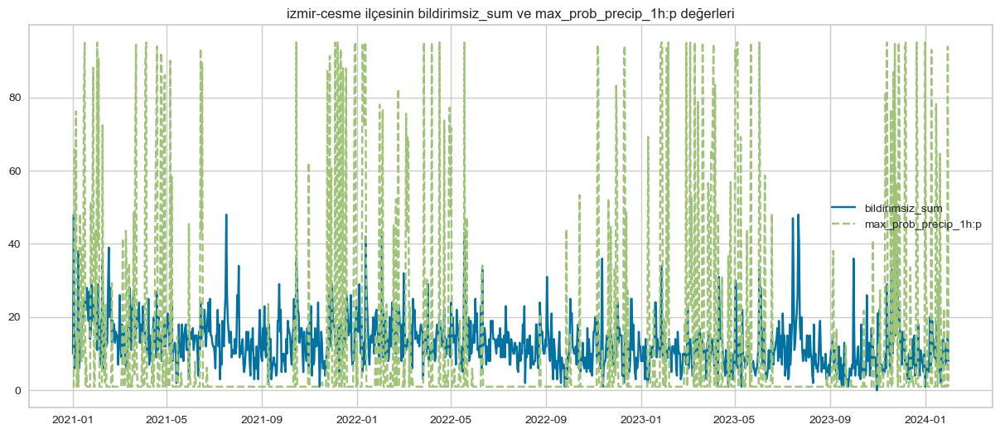

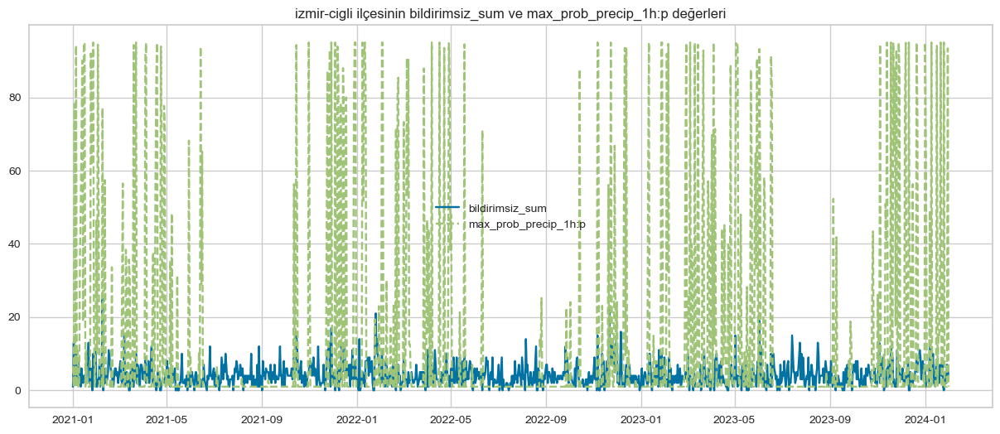

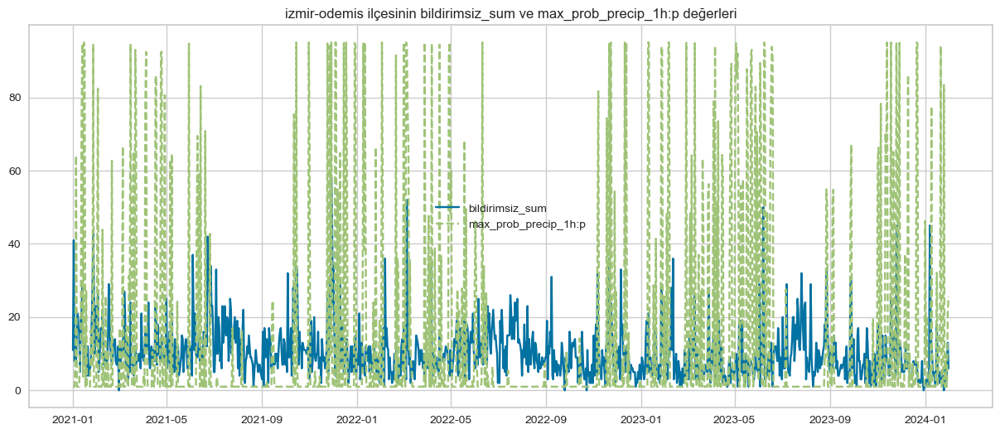

In [51]:
for i in ilceler:
    ilce_hava_kesinti(df,i,"bildirimsiz_sum","max_prob_precip_1h:p")

# Test Verisi

In [52]:
test_df=test.copy()

In [53]:
test_df["yil"]=test_df["tarih"].dt.year
test_df["ay"]=test_df["tarih"].dt.month
test_df["haftanin_gunu"]=test_df["tarih"].dt.dayofweek
test_df["mevsim"]=test_df["ay"].apply(lambda x: "kış" if x==1 or x==2 or x==12 else "ilkbahar" if  x==3 or x==4 or x==5 else "yaz" if  x==6 or x==7 or x==8 else "sonbahar")
test_df=pd.merge(test_df,new_weather,how="left",on=["tarih","ilce"])
tatil_df=holiday.drop(["Yıl","Ay","Gün","Tatil Adı"],axis=1)
test_df=pd.merge(test_df,tatil_df,how="left",on="tarih")
for i in range(0,len(tatil_df)):
    if test_df["haftanin_gunu"][i]==6:
        test_df["tatil_mi"][i]=1
test_df["tatil_mi"].fillna(0,inplace=True)
test_df.head()

,tarih,ilce,bildirimli_sum,yil,ay,haftanin_gunu,mevsim,min_t_2m:C,max_t_2m:C,mean_t_2m:C,t_difference_2m:C,max_global_rad:W,max_relative_humidity_2m:p,max_wind_speed_10m:ms,max_prob_precip_1h:p,min_t_apparent:C,max_t_apparent:C,mean_t_apparent:C,t_apparent_difference:C,tatil_mi
0,2024-02-01,izmir-aliaga,0,2024,2,3,kış,5.0,12.0,7.616667,7.0,557.9,85.3,7.0,1.0,1.0,16.6,6.395833,15.6,0.0
1,2024-02-01,izmir-bayindir,1,2024,2,3,kış,2.9,12.6,6.429167,9.7,568.9,94.1,2.8,1.0,0.2,17.3,6.262500,17.1,0.0
2,2024-02-01,izmir-bayrakli,0,2024,2,3,kış,3.9,12.0,6.954167,8.1,567.3,92.0,3.3,1.0,1.3,16.6,6.920833,15.3,0.0
3,2024-02-01,izmir-bergama,1,2024,2,3,kış,2.8,11.4,6.575000,8.6,549.1,87.4,5.8,1.0,1.4,16.0,5.591667,14.6,0.0
4,2024-02-01,izmir-bornova,1,2024,2,3,kış,2.9,11.3,6.054167,8.4,567.0,97.2,3.6,1.0,-0.3,16.2,5.666667,16.5,0.0


In [54]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52913 entries, 0 to 52912
Data columns (total 21 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   tarih                       52913 non-null  datetime64[ns]
 1   ilce                        52913 non-null  object        
 2   bildirimsiz_sum             52913 non-null  float64       
 3   bildirimli_sum              52913 non-null  float64       
 4   yil                         52913 non-null  int32         
 5   ay                          52913 non-null  int32         
 6   haftanin_gunu               52913 non-null  int32         
 7   mevsim                      52913 non-null  object        
 8   min_t_2m:C                  52913 non-null  float64       
 9   max_t_2m:C                  52913 non-null  float64       
 10  mean_t_2m:C                 52913 non-null  float64       
 11  t_difference_2m:C           52913 non-null  float64   

In [55]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1363 entries, 0 to 1362
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   tarih                       1363 non-null   datetime64[ns]
 1   ilce                        1363 non-null   object        
 2   bildirimli_sum              1363 non-null   int64         
 3   yil                         1363 non-null   int32         
 4   ay                          1363 non-null   int32         
 5   haftanin_gunu               1363 non-null   int32         
 6   mevsim                      1363 non-null   object        
 7   min_t_2m:C                  1363 non-null   float64       
 8   max_t_2m:C                  1363 non-null   float64       
 9   mean_t_2m:C                 1363 non-null   float64       
 10  t_difference_2m:C           1363 non-null   float64       
 11  max_global_rad:W            1363 non-null   float64     